# Semantic Segmentation Project
### Introduction
In this project, we focus on semantic segmentation using the Cityscapes dataset. Semantic segmentation is a task where each pixel of an image is assigned a class label, allowing for precise understanding of objects and their boundaries within a scene. The Cityscapes dataset is well-suited for this task, providing high-quality images and detailed annotations of urban street scenes.

### Objective
We will implement a U-Net model, a popular architecture for image segmentation tasks, and train it on the Cityscapes dataset. The goal is to predict a label for each pixel in the image, which corresponds to different object categories such as roads, buildings, vehicles, pedestrians, and more.

By the end of this project, the model will be able to accurately segment images and classify each pixel into its respective category, providing a clear breakdown of urban scenes.

### Table of Contents:
* Import Libraries and Setup:
  Here, we will import necessary libraries such as torch, torchvision, and data preprocessing libraries.

* Data Loading and Preprocessing:
  In this section, we'll load the Cityscapes dataset and prepare the images and labels for training, including any necessary transformations.

* Define the U-Net Model:
  We'll build and explain the U-Net architecture used for semantic segmentation.

* Training Setup:
  Define the loss functions, optimizers, and training loop configuration to fit the model on the Cityscapes data.

* Model Training and Evaluation:
  Train the model and evaluate its performance on validation data, displaying metrics and visualizing the segmentation results.

* Conclusion and Future Work:
  Summarize the findings, discuss the performance of the model, and explore potential improvements or future directions.

## Setting-up the notebook
I will ignore all warinings, importing the modules I will use in this notebook and I will use the 2 GPUs on kaggle to be used by PyTorch.

In [1]:
import os
import cv2
import json
import torch
import numpy as np
import pandas as pd
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.v2 as T
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
from typing import List
from collections import namedtuple
from torch.utils.data import DataLoader, Dataset
from sklearn.model_selection import train_test_split
from torchvision.transforms import Compose, ToTensor

import warnings
warnings.filterwarnings('ignore')

## Labels

In [2]:
#--------------------------------------------------------------------------------
# Definitions
#--------------------------------------------------------------------------------

# a label and all meta information
Label = namedtuple( 'Label' , [

    'name'        , # The identifier of this label, e.g. 'car', 'person', ... .
                    # We use them to uniquely name a class

    'id'          , # An integer ID that is associated with this label.
                    # The IDs are used to represent the label in ground truth images
                    # An ID of -1 means that this label does not have an ID and thus
                    # is ignored when creating ground truth images (e.g. license plate).

    'trainId'     , # An integer ID that overwrites the ID above, when creating ground truth
                    # images for training.
                    # For training, multiple labels might have the same ID. Then, these labels
                    # are mapped to the same class in the ground truth images. For the inverse
                    # mapping, we use the label that is defined first in the list below.
                    # For example, mapping all void-type classes to the same ID in training,
                    # might make sense for some approaches.

    'category'    , # The name of the category that this label belongs to

    'categoryId'  , # The ID of this category. Used to create ground truth images
                    # on category level.

    'hasInstances', # Whether this label distinguishes between single instances or not

    'ignoreInEval', # Whether pixels having this class as ground truth label are ignored
                    # during evaluations or not

    'color'       , # The color of this label
    ] )


#--------------------------------------------------------------------------------
# A list of all labels
#--------------------------------------------------------------------------------

# Please adapt the train IDs as appropriate for you approach.
# Note that you might want to ignore labels with ID 255 during training.
# Make sure to provide your results using the original IDs and not the training IDs.
# Note that many IDs are ignored in evaluation and thus you never need to predict these!

labels = [
    #       name                     id    trainId   category            catId     hasInstances   ignoreInEval   color
    Label(  'unlabeled'            ,  0 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'ego vehicle'          ,  1 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'rectification border' ,  2 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'out of roi'           ,  3 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'static'               ,  4 ,      255 , 'void'            , 0       , False        , True         , (  0,  0,  0) ),
    Label(  'dynamic'              ,  5 ,      255 , 'void'            , 0       , False        , True         , (111, 74,  0) ),
    Label(  'ground'               ,  6 ,      255 , 'void'            , 0       , False        , True         , ( 81,  0, 81) ),
    Label(  'road'                 ,  7 ,        0 , 'ground'          , 1       , False        , False        , (128, 64,128) ),
    Label(  'sidewalk'             ,  8 ,        1 , 'ground'          , 1       , False        , False        , (244, 35,232) ),
    Label(  'parking'              ,  9 ,      255 , 'ground'          , 1       , False        , True         , (250,170,160) ),
    Label(  'rail track'           , 10 ,      255 , 'ground'          , 1       , False        , True         , (230,150,140) ),
    Label(  'building'             , 11 ,        2 , 'construction'    , 2       , False        , False        , ( 70, 70, 70) ),
    Label(  'wall'                 , 12 ,        3 , 'construction'    , 2       , False        , False        , (102,102,156) ),
    Label(  'fence'                , 13 ,        4 , 'construction'    , 2       , False        , False        , (190,153,153) ),
    Label(  'guard rail'           , 14 ,      255 , 'construction'    , 2       , False        , True         , (180,165,180) ),
    Label(  'bridge'               , 15 ,      255 , 'construction'    , 2       , False        , True         , (150,100,100) ),
    Label(  'tunnel'               , 16 ,      255 , 'construction'    , 2       , False        , True         , (150,120, 90) ),
    Label(  'pole'                 , 17 ,        5 , 'object'          , 3       , False        , False        , (153,153,153) ),
    Label(  'polegroup'            , 18 ,      255 , 'object'          , 3       , False        , True         , (153,153,153) ),
    Label(  'traffic light'        , 19 ,        6 , 'object'          , 3       , False        , False        , (250,170, 30) ),
    Label(  'traffic sign'         , 20 ,        7 , 'object'          , 3       , False        , False        , (220,220,  0) ),
    Label(  'vegetation'           , 21 ,        8 , 'nature'          , 4       , False        , False        , (107,142, 35) ),
    Label(  'terrain'              , 22 ,        9 , 'nature'          , 4       , False        , False        , (152,251,152) ),
    Label(  'sky'                  , 23 ,       10 , 'sky'             , 5       , False        , False        , ( 70,130,180) ),
    Label(  'person'               , 24 ,       11 , 'human'           , 6       , True         , False        , (220, 20, 60) ),
    Label(  'rider'                , 25 ,       12 , 'human'           , 6       , True         , False        , (255,  0,  0) ),
    Label(  'car'                  , 26 ,       13 , 'vehicle'         , 7       , True         , False        , (  0,  0,142) ),
    Label(  'truck'                , 27 ,       14 , 'vehicle'         , 7       , True         , False        , (  0,  0, 70) ),
    Label(  'bus'                  , 28 ,       15 , 'vehicle'         , 7       , True         , False        , (  0, 60,100) ),
    Label(  'caravan'              , 29 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0, 90) ),
    Label(  'trailer'              , 30 ,      255 , 'vehicle'         , 7       , True         , True         , (  0,  0,110) ),
    Label(  'train'                , 31 ,       16 , 'vehicle'         , 7       , True         , False        , (  0, 80,100) ),
    Label(  'motorcycle'           , 32 ,       17 , 'vehicle'         , 7       , True         , False        , (  0,  0,230) ),
    Label(  'bicycle'              , 33 ,       18 , 'vehicle'         , 7       , True         , False        , (119, 11, 32) ),
    Label(  'license plate'        , 34 ,       19 , 'vehicle'         , 7       , False        , True         , (  0,  0,142) ),
]

# function to get the label from the name and the color
def find_label(name):
    for label in labels:
        if label.name == name:
            return label.trainId, label.color
    return 255, (0,0,0)

In [48]:
def find_color(id_):
    if id_ != 20:
        for label in labels:
            if label.trainId == id_:
                return label.color
    return (0,0,0)

## Loading Data
In this section, we will load the image paths from the Cityscapes dataset and store them in a CSV file. The dataset will be split into training and validation sets, with 80% of the images used for training and 20% reserved for validation. After the split, the data distribution will be as follows:

* Training Set: 1904 images
* Validation Set: 119 images

We will proceed by saving the image paths, performing the split, and ensuring the data is ready for the subsequent stages of model training and evaluation.

In [3]:
#For Working Within Kaggle - Seif
#--------------------------------------------------------------------------------
train_images_folder = '/kaggle/input/cityscapes-segmentation/images/train'
train_labels_folder = '/kaggle/input/cityscapes-segmentation/labels/train'

training_csv_file_path = '/kaggle/working/cityscapes_training.csv'
val_csv_file_path = '/kaggle/working/cityscapes_val.csv'
#--------------------------------------------------------------------------------

#For Working Locally - Youssif
#--------------------------------------------------------------------------------
# current_dir = os.path.dirname(os.getcwd())
# train_images_folder = os.path.join(current_dir, 'DataSet\\Images\\Train_Set')
# train_labels_folder = os.path.join(current_dir, 'DataSet\\Labels\\train')

# training_csv_file_path = os.path.join(current_dir, 'DataSet\\cityscapes_training.csv')
# val_csv_file_path = os.path.join(current_dir, 'DataSet\\cityscapes_val.csv')
#--------------------------------------------------------------------------------

data = {
    'image_path': [],
    'label_mask_path': [],
    'label_json_path': []
}

for city in os.listdir(train_images_folder):
    city_image_folder = os.path.join(train_images_folder, city)
    city_label_folder = os.path.join(train_labels_folder, city)
    # print(f"Processing {city} ...")
    
    if os.path.isdir(city_image_folder):
        for image_file in os.listdir(city_image_folder):
            # print(f"Processing {image_file} ...")
            if image_file.endswith('_leftImg8bit.png'):
                image_name_base = image_file.replace('_leftImg8bit.png', '')
                label_mask_file = f"{image_name_base}_gtFine_labelTrainIds.png"
                label_json_file = f"{image_name_base}_gtFine_polygons.json"
                
                data['image_path'].append(os.path.join(city_image_folder, image_file))
                data['label_mask_path'].append(os.path.join(city_label_folder, label_mask_file))
                data['label_json_path'].append(os.path.join(city_label_folder, label_json_file))

df = pd.DataFrame(data)

train_df, val_df = train_test_split(df, test_size=0.2, random_state=23, shuffle=True)

train_df.to_csv(training_csv_file_path, index=False)
val_df.to_csv(val_csv_file_path, index=False)

In [4]:
#For Working Within Kaggle - Seif
#--------------------------------------------------------------------------------
test_images_folder = '/kaggle/input/cityscapes-segmentation/images/test'

test_csv_file_path = '/kaggle/working/cityscapes_test.csv'
#--------------------------------------------------------------------------------

#For Working Locally - Youssif
#--------------------------------------------------------------------------------
# test_images_folder = os.path.join(current_dir, 'DataSet\\Images\\Test_Set')

# test_csv_file_path = os.path.join(current_dir, 'DataSet\\cityscapes_test.csv')
#--------------------------------------------------------------------------------

test_data = {
    'image_path': []
}

for city in os.listdir(test_images_folder):
    city_image_folder = os.path.join(test_images_folder, city)
    
    if os.path.isdir(city_image_folder):
        for image_file in os.listdir(city_image_folder):
            if image_file.endswith('_leftImg8bit.png'):
                test_data['image_path'].append(os.path.join(city_image_folder, image_file))

test_df = pd.DataFrame(test_data)

test_df.to_csv(test_csv_file_path, index=False)

## EDA (Exploratory Data Analysis)
We have gathered some initial information about the Cityscapes dataset from its official website, which provided insights into the structure and labeling of the data. In this section, we will perform a simple EDA to better understand the dataset and guide us in the preprocessing and model training stages.

The EDA will help us:

* Analyze the distribution of classes and pixels for each label.
* Visualize sample images and their corresponding segmentation masks.
* Identify any potential data imbalances or challenges that may arise during training.

This basic analysis will allow us to make informed decisions during the data preprocessing and model design phases.

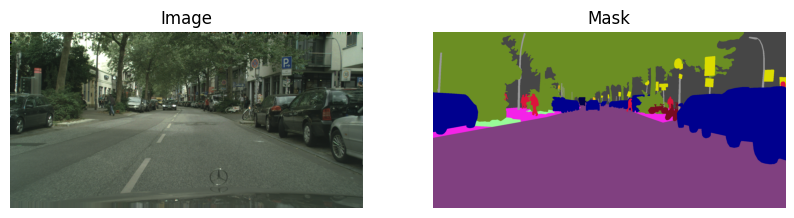

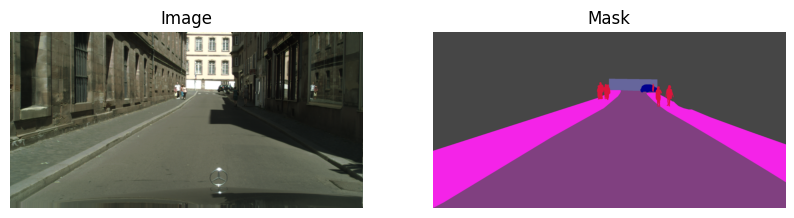

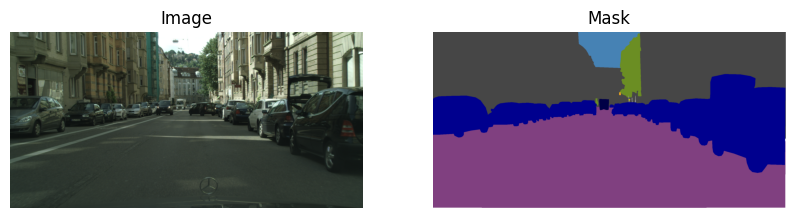

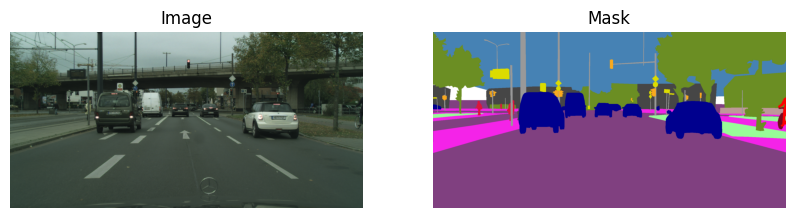

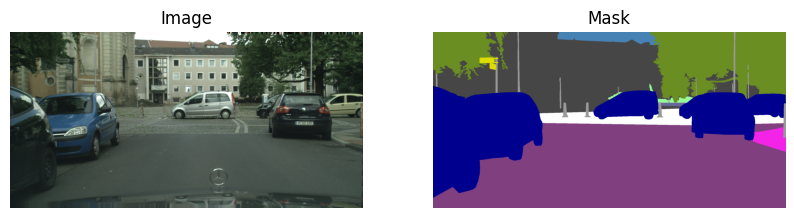

In [5]:
# Displaying a sample of images and masks
def show_img_mask(row):
    image = cv2.cvtColor(cv2.imread(row['image_path']), cv2.COLOR_BGR2RGB)
    mask = cv2.imread(row['label_mask_path'])
    # We used the json file to fill out the polygons in the mask and also color it
    json_data = json.load(open(row['label_json_path']))

    for obj in json_data['objects']:
        label = obj['label']
        trainId, color = find_label(label)
        if trainId != 255:
            mask = cv2.fillPoly(mask, np.array([obj['polygon']], dtype=np.int32), color)

    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(image)
    ax[0].axis('off')
    ax[0].set_title('Image')
    ax[1].imshow(mask, cmap='gray')
    ax[1].axis('off')
    ax[1].set_title('Mask')
    plt.show()

rSample = train_df.sample(5)
for index, row in rSample.iterrows():
    show_img_mask(row)

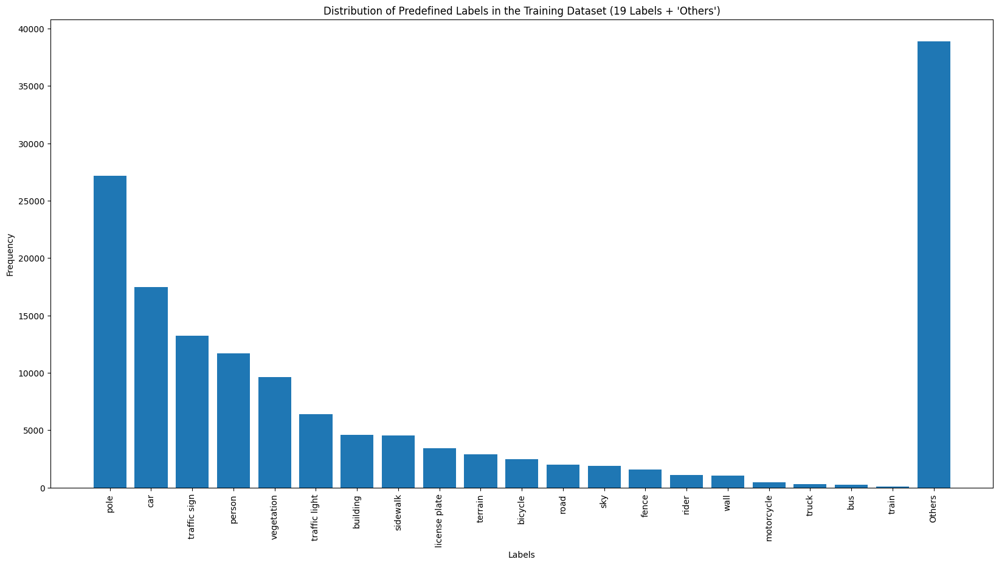

Labels not found in predefined labels: {'static': 25037, 'cargroup': 1209, 'ego vehicle': 1904, 'out of roi': 1904, 'parking': 664, 'dynamic': 2321, 'ground': 1197, 'rectification border': 2768, 'bicyclegroup': 558, 'persongroup': 553, 'polegroup': 196, 'trailer': 47, 'bridge': 279, 'rail track': 76, 'ridergroup': 9, 'caravan': 43, 'tunnel': 18, 'motorcyclegroup': 7, 'guard rail': 73, 'truckgroup': 1}


In [55]:
# Analyzing the distribution of the labels accross the train dataset
predefined_labels = {label.name: 0 for label in labels if label.trainId != 255}
predefined_labels['Others'] = 0  # Add 'Others' to track undefined labels
labels_not_found = {}  # For tracking any undefined labels
dimensions_freq = {}
 
for index, row in train_df.iterrows():
    json_data = json.load(open(row['label_json_path']))
 
    dimensions = f"{json_data['imgWidth']}x{json_data['imgHeight']}"
    dimensions_freq[dimensions] = dimensions_freq.get(dimensions, 0) + 1
 
    for obj in json_data['objects']:
        label = obj['label']
        if label in predefined_labels:
            predefined_labels[label] += 1
        else:
            # Increment the count for 'Others' when the label is not one of the predefined labels
            predefined_labels['Others'] += 1
            # Optionally, track the specific labels that were not found
            if label not in labels_not_found:
                labels_not_found[label] = 1
            else:
                labels_not_found[label] += 1
 
# Sort
sorted_labels_freq = dict(sorted(predefined_labels.items(), key=lambda item: item[1], reverse=True))
 
# Move 'Others' to the last position in the sorted dictionary
if 'Others' in sorted_labels_freq:
    sorted_labels_freq['Others'] = sorted_labels_freq.pop('Others')
 

plt.figure(figsize=(20, 10))
plt.bar(sorted_labels_freq.keys(), sorted_labels_freq.values())
plt.xticks(rotation=90)
plt.title("Distribution of Predefined Labels in the Training Dataset (19 Labels + 'Others')")
plt.xlabel("Labels")
plt.ylabel("Frequency")
plt.show()
 
# Display any labels that were not found in the predefined list
print("Labels not found in predefined labels:", labels_not_found)

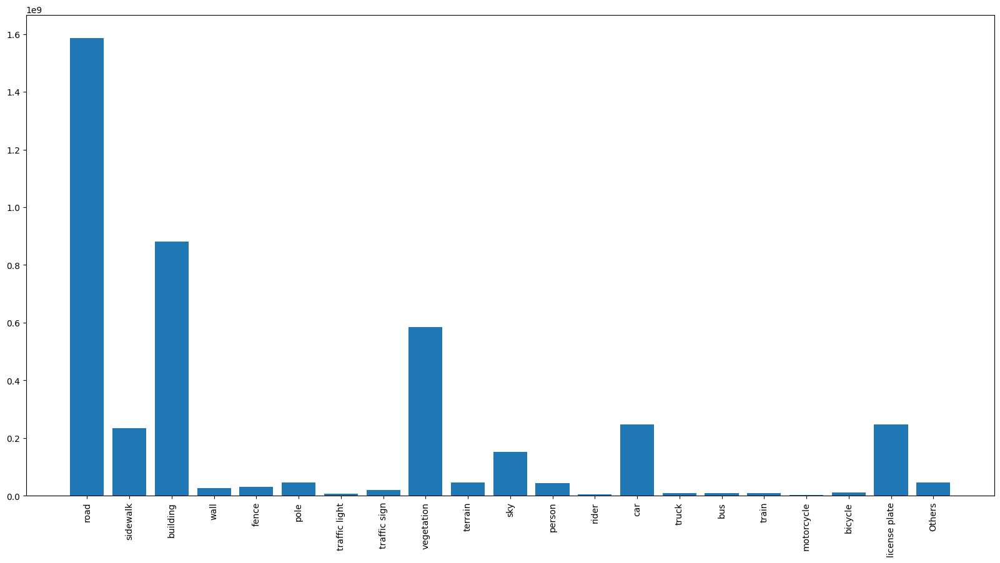

In [53]:
# Pixels Covered by Each Label
def get_labels_pixels(row):
    mask = cv2.imread(row['label_mask_path'])
    json_data = json.load(open(row['label_json_path']))

    for obj in json_data['objects']:
        label = obj['label']
        trainId, color = find_label(label)
        if trainId != 255:
            mask = cv2.fillPoly(mask, np.array([obj['polygon']], dtype=np.int32), color)

    return mask

train_df['label_mask'] = train_df.apply(get_labels_pixels, axis=1)

labels_pixels = {label.name: 0 for label in labels if label.trainId != 255}
labels_pixels['Others'] = 0

for index, row in train_df.iterrows():
    for label in labels:
        if label.trainId != 255:
            labels_pixels[label.name] += np.sum((row['label_mask'][:,:,0] == label.color[0]) &
                                                (row['label_mask'][:,:,1] == label.color[1]) &
                                                (row['label_mask'][:,:,2] == label.color[2]))
        else:
            labels_pixels['Others'] += np.sum((row['label_mask'][:,:,0] == label.color[0]) &
                                              (row['label_mask'][:,:,1] == label.color[1]) &
                                              (row['label_mask'][:,:,2] == label.color[2]))

plt.figure(figsize=(20, 10))
plt.bar(labels_pixels.keys(), labels_pixels.values())
plt.xticks(rotation=90)
plt.show()

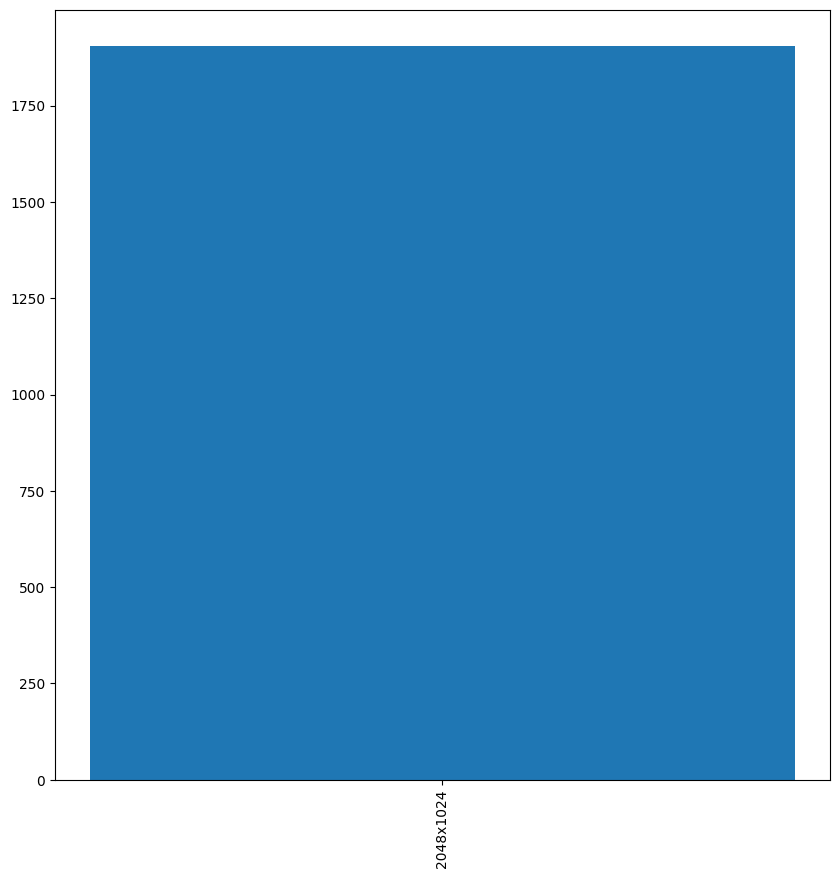

In [8]:
# Bar Plot for the Dimensions of the Images to make sure that all of them have the same size
plt.figure(figsize=(10, 10))
plt.bar(dimensions_freq.keys(), dimensions_freq.values())
plt.xticks(rotation=90)
plt.show()

# All Images have the same dimensions

## Preprocessing & Augmentation
To improve the generalization of our model and enhance its performance, we will apply data augmentation techniques to the training images. Augmentation helps by artificially increasing the diversity of the training set, making the model more robust to variations in real-world data.

### Preprocessing:
* Resizing: We will resize all images and masks to a fixed size to ensure consistency in input dimensions.
* Mask Encoding: Since we are working with labeled segmentation masks, we will preprocess them to match the format expected by the model, we will encode the classes with onehotencoding.
* GaussianBlur: With it we will remove any noise in the images.

### Augmentation Techniques:
* Random Flips: Horizontal flips to simulate different camera angles.
* Rotation: Apply random rotations to account for various orientations.
By augmenting the training data, we aim to create a more varied dataset that helps the model generalize better to unseen data.

In [5]:
# Getting the GPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Using device:', device)

Using device: cuda


In [6]:
#TODO : TRAIN DATA PREPROCESSING PIPELINE
csv_keys = ['image_path', 'label_mask_path', 'label_json_path']

In [7]:
def augment_image_and_mask(image, mask):
    # Apply random horizontal flip
    if torch.rand(1).item() < 0.5:  
        image = T.functional.horizontal_flip(image)
        mask = T.functional.horizontal_flip(mask)
    
    # Apply random rotation with 12 degree angle    
    if torch.rand(1).item() < 0.5:
        angle = torch.randint(-12, 12, (1,)).item()
        image = T.functional.rotate(image, angle)
        mask = T.functional.rotate(mask, angle)
    
    # Adding gaussianblur to remove the noise in the images    
    image = T.functional.gaussian_blur(image, 1)
    mask = T.functional.gaussian_blur(mask, 1)

    return image, mask

In [8]:
class Dataset(Dataset):
    def __init__(self, input_dataframe: pd.DataFrame, KeysOfInterest: List[str], mask=True, aug = True): # TODO: add parameters if needed
        self.koi = KeysOfInterest
        self.input_dataframe = input_dataframe[self.koi]
        self.mask_state = mask
        self.aug_state = aug

    def __getitem__(self, item: int):
        img_path = self.input_dataframe.iloc[item]['image_path']
        
        # Read the image and resize it
        image = Image.open(img_path).convert("RGB") 
        image = image.resize((512,256))
        
        # Set the mask to None this is the case for the test data
        mask = torch.empty(5)
        
        if self.mask_state:
            # Load the mask if you have it.
            mask_path = self.input_dataframe.iloc[item]['label_mask_path']
            mask = Image.open(mask_path).convert("L")
            mask = mask.resize((512,256))
            
            if self.aug_state:
                # Augment the data if yoou need
                image, mask = augment_image_and_mask(image, mask)
            
            mask_arr = np.array(mask)
            mask_arr[mask_arr > 19] = 20

            # One-hot encoding
            num_classes = 21
            mask_one_hot = np.eye(num_classes)[mask_arr]

            # permute the mask from (H, W, 21) to (21, H, W) 
            mask_one_hot = np.transpose(mask_one_hot, (2, 0, 1))
            mask = torch.tensor(mask_one_hot, dtype=torch.float32)
            image = ToTensor()(image)
            return image, mask
        
        image = ToTensor()(image)
        return image, mask 
        
    def __len__(self):
        return len(self.input_dataframe)

In [9]:
#TODO : Initilize your datasets
ds_train=Dataset(input_dataframe=train_df,
                KeysOfInterest=csv_keys)

ds_val=Dataset(input_dataframe=val_df,
                KeysOfInterest=csv_keys,
                aug = False)

ds_test=Dataset(input_dataframe=test_df,
                KeysOfInterest=["image_path"], 
                mask = False)

In [10]:
BATCH_SIZE = 4
workers = 4 

dl_train = DataLoader(dataset=ds_train, batch_size= BATCH_SIZE, shuffle=True, num_workers=workers)
dl_val = DataLoader(dataset=ds_val, batch_size= BATCH_SIZE, num_workers=workers, shuffle=True)

dl_test = DataLoader(dataset=ds_test, batch_size= 1, num_workers=workers, shuffle=False)

Sample 1:


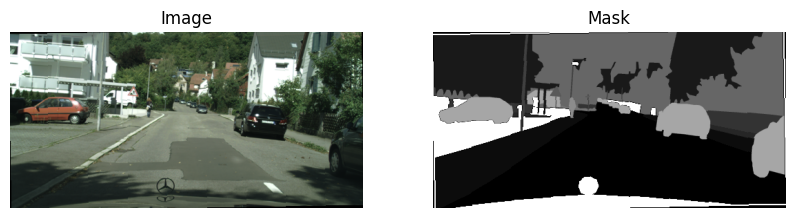

Sample 2:


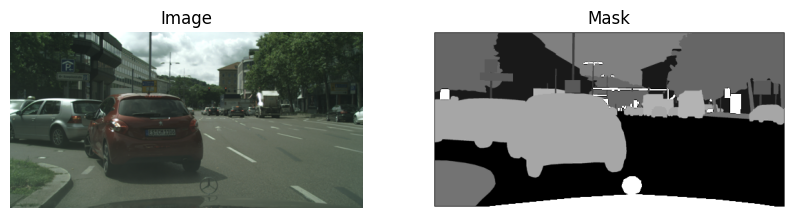

Sample 3:


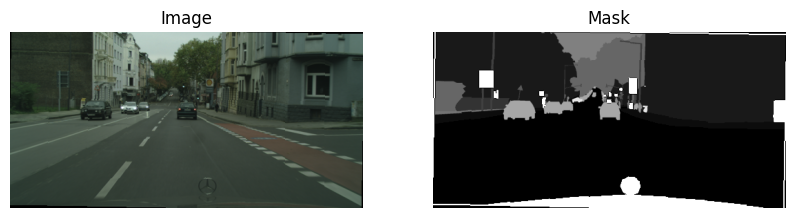

Sample 4:


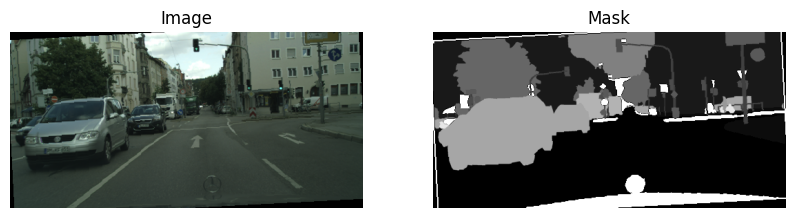

Sample 5:


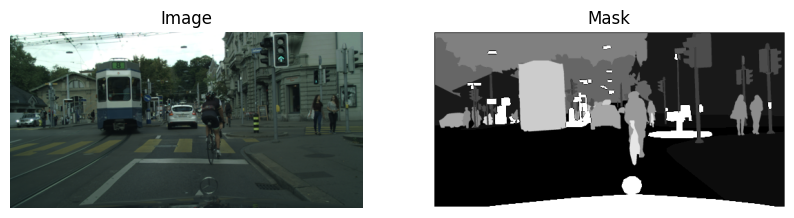

Sample 6:


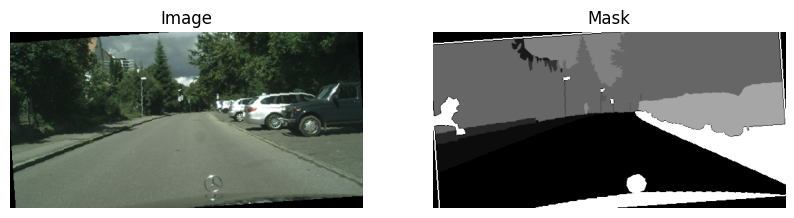

Sample 7:


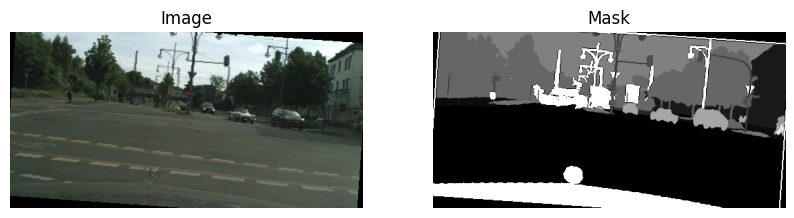

Sample 8:


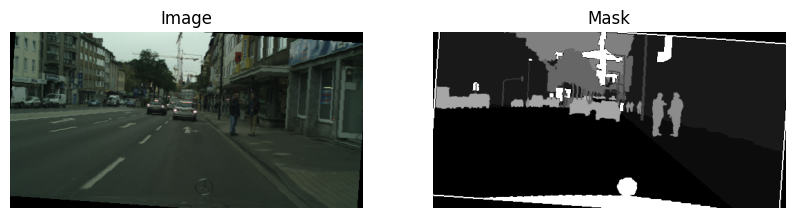

In [15]:
# Function to show a single sample (image and mask)
def show_sample(image_tensor, mask_tensor):
    if image_tensor.is_cuda:
        image_tensor = image_tensor.cpu()
    if mask_tensor is not None and mask_tensor.is_cuda:
        mask_tensor = mask_tensor.cpu()

    image = image_tensor.permute(1, 2, 0).numpy()
    mask = torch.argmax(mask_tensor, dim=0).numpy()

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(image)
    plt.axis('off')
    plt.title('Image')
    plt.subplot(1, 2, 2)
    im = plt.imshow(mask, cmap='gray')
    plt.axis('off')
    plt.title('Mask')
    plt.show()

# Function to show multiple samples from a batch
def show_data_samples(dataloader, num_batch):
    for i, (image_batch, mask_batch) in enumerate(dataloader):
        if i >= num_batch:
            break

        batch_size = image_batch.size(0)
        for j in range(batch_size):
            print(f"Sample {i*batch_size + j + 1}:")
            show_sample(image_batch[j], mask_batch[j])

show_data_samples(dl_train, 2)

## Modeling 
We used UNeT model and SiLU activation function.

In [11]:
class Convblock(nn.Module):
    def __init__(self, in_chs, out_chs):
        super().__init__()
        self.convblock = nn.Sequential(
            nn.Conv2d(in_chs, out_chs, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_chs),
            nn.SiLU(inplace=True),
            nn.Conv2d(out_chs, out_chs, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(out_chs),
            nn.SiLU(inplace=True),
        )

    def forward(self, x):
        return self.convblock(x)

In [12]:
class UNet(nn.Module):

    def __init__(self,in_chs,out_chs,fts=[64,128,256,512]):
        super(UNet, self).__init__()

        self.downs = nn.ModuleList()
        self.ups = nn.ModuleList()
        self.pool = nn.MaxPool2d(2, 2)

        # Encoder Network
        for ft in fts:
            self.downs.append(Convblock(in_chs, ft))
            in_chs = ft

        # BottelNeck
        self.neck = Convblock(fts[-1], fts[-1]*2)

        # Decoder Network
        for ft in reversed(fts):
            self.ups.append(nn.ConvTranspose2d(ft*2, ft, 2, 2))
            self.ups.append(Convblock(ft*2, ft))

        self.out = nn.Conv2d(fts[0], out_chs, 1, 1)        

    def forward(self,x):

        skp_conns = []
        for down in self.downs:
            x = down(x)
            skp_conns.append(x)
            x = self.pool(x)
        
        x = self.neck(x)

        skp_conns = skp_conns[::-1]
        for i in range(0, len(self.ups), 2):
            x = self.ups[i](x)
            cnct_skp = torch.cat((x, skp_conns[i//2]), dim=1)
            x = self.ups[i+1](cnct_skp)

        return self.out(x)

In [18]:
# making early stop to stop training when it stop improving we are monitoring the validation loss
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0):
        self.patience = patience
        self.min_delta = min_delta
        self.best_loss = None
        self.counter = 0
        self.early_stop = False

    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0 
        else:
            self.counter += 1
            print(f"EarlyStopping counter: {self.counter} out of {self.patience}")
            if self.counter >= self.patience:
                self.early_stop = True

In [13]:
#TODO : Write the loss function you are going to use
model = UNet(in_chs=3,out_chs=21).to(device)

# Check if multiple GPUs are available
if torch.cuda.device_count() > 1:
    print("Using", torch.cuda.device_count(), "GPUs!")
    # Wrap the model with DataParallel to use multiple GPUs
    model = nn.DataParallel(model) 

Using 2 GPUs!


In [20]:
# This function to plot the images during training
def show(imgs, outputs, labels):

    for img, output, label in zip(imgs, outputs, labels):
    
        # Migrate the data to the cpu
        img = img.cpu()
        output = output.cpu()
        label = label.cpu()
    
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(img.permute(1, 2, 0).numpy())
        plt.axis('off')
        plt.title('Image')

        plt.subplot(1, 3, 2)
        plt.imshow(torch.argmax(output, dim=0).numpy(), cmap='gray')
        plt.axis('off')
        plt.title('Prediction')

        plt.subplot(1, 3, 3)
        plt.imshow(torch.argmax(label, dim=0).numpy(), cmap='gray')
        plt.axis('off')
        plt.title('Ground Truth')

    plt.show()

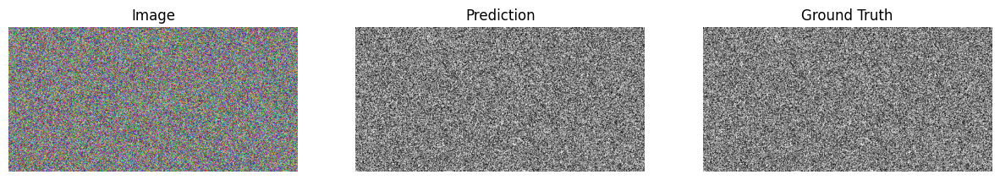

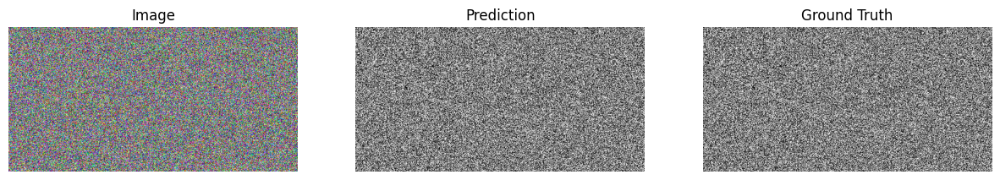

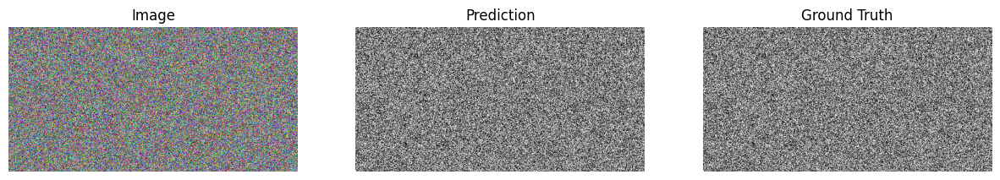

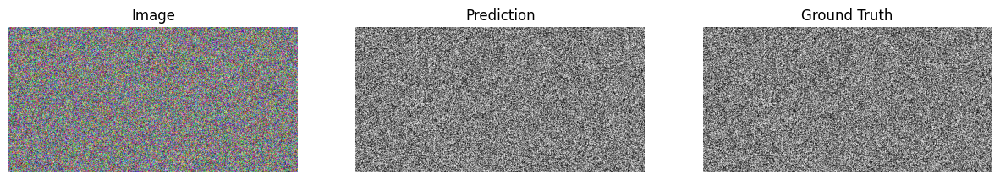

In [21]:
def test_show_before_training():
    # Creating dummy data
    img_height, img_width = 256, 512
    
    # Random RGB image tensor [batch_size, 3, height, width]
    imgs = torch.rand(4, 3, img_height, img_width)

    # Random mask tensor [batch_size, num_classes, height, width]
    outputs = torch.rand(4, 21, img_height, img_width)
    
    # Call the show function to visualize the random data
    show(imgs, outputs, outputs)

# Test the show function with dummy data
test_show_before_training()

In [22]:
def train_model(model, train_loader, val_loader, num_epochs, device, criterion, optimizer, patience=25):
    best_val_loss = float('inf')
    early_stopping_counter = 0  

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        # --- TRAINING PHASE ---
        model.train()
        running_loss = 0.0
       
        for inputs, labels in tqdm(train_loader):
            inputs = inputs.to(device)
            labels = labels.to(device)
            
            # inputs: [batch_size, channels, height, width]
            # labels: [batch_size, num_classes, height, width]
            
            # Zero the parameter gradients
            optimizer.zero_grad()

            # Forward pass
            outputs = model(inputs)

#             print(inputs.shape)
#             print(labels.shape)
#             print(outputs.shape)

            # Compute loss
            loss = criterion(outputs, labels)
            
            # Backward pass
            loss.backward()
            
            optimizer.step()

            running_loss += loss.item()
        
        if(epoch % 5 == 0):
            print("Training Output")
            show(inputs,outputs,labels)
            
        # --- VALIDATION PHASE ---
        model.eval()
        val_loss = 0.0
        
        with torch.no_grad():
            for inputs, labels in tqdm(val_loader):
                inputs = inputs.to(device)
                labels = labels.to(device)

                # Forward pass
                outputs = model(inputs)
                val_loss += criterion(outputs, labels).item()
            
            if(epoch % 5 == 0):
                print("Validation Output")
                show(inputs,outputs,labels)

        train_loss = running_loss / len(train_loader)
        val_loss /= len(val_loader)

        train_losses.append(train_loss)
        val_losses.append(val_loss)

        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'UNET.pth')
            early_stopping_counter = 0
        else:
            early_stopping_counter += 1

        if early_stopping_counter >= patience:
            print("Early stopping triggered.")
            break

    print('Finished Training')
    return train_losses, val_losses

In [23]:
#TODO : Write the evaluation metrics you are going to use
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.AdamW(model.parameters(), lr=0.001)

100%|██████████| 476/476 [02:39<00:00,  2.98it/s]


Training Output


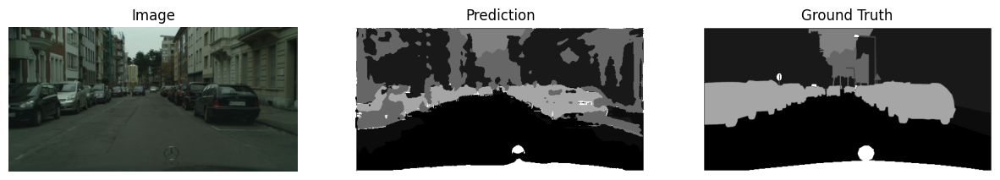

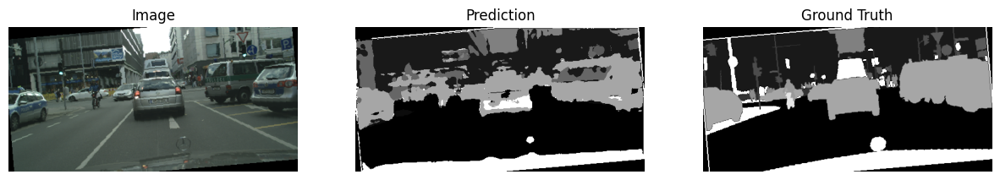

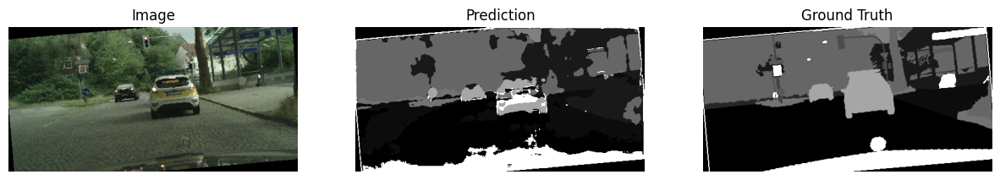

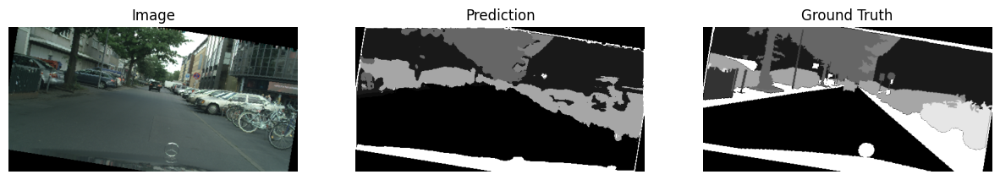

100%|██████████| 119/119 [00:33<00:00,  3.60it/s]


Validation Output


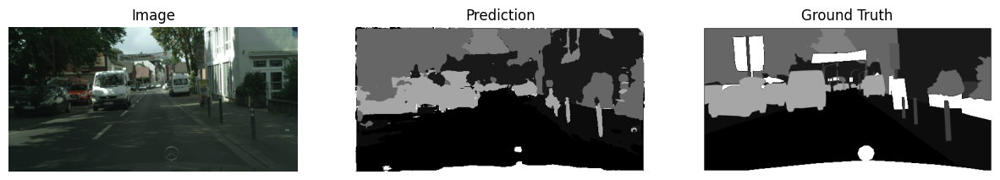

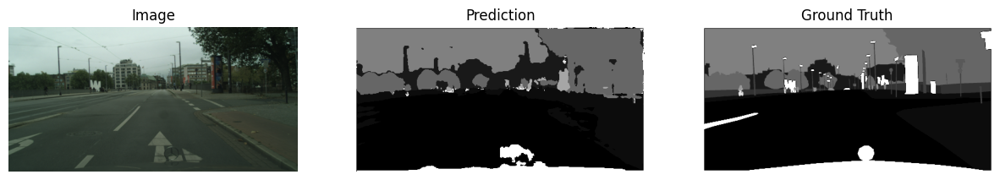

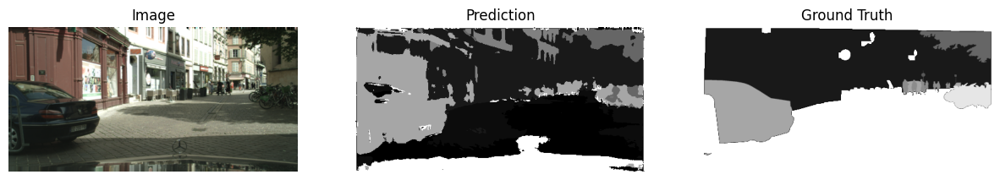

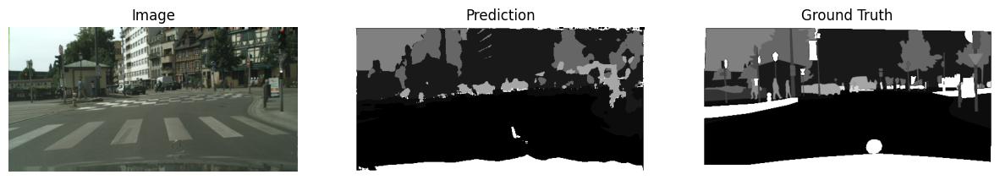

Epoch [1/100], Train Loss: 1.1318, Val Loss: 0.9185


100%|██████████| 119/119 [00:34<00:00,  3.50it/s]


Epoch [2/100], Train Loss: 0.8737, Val Loss: 0.8108


100%|██████████| 119/119 [00:35<00:00,  3.39it/s]


Epoch [3/100], Train Loss: 0.8007, Val Loss: 0.7549


100%|██████████| 119/119 [00:34<00:00,  3.48it/s]


Epoch [4/100], Train Loss: 0.7493, Val Loss: 0.8286


100%|██████████| 119/119 [00:34<00:00,  3.49it/s]


Epoch [5/100], Train Loss: 0.7205, Val Loss: 0.7405


100%|██████████| 476/476 [02:41<00:00,  2.95it/s]


Training Output


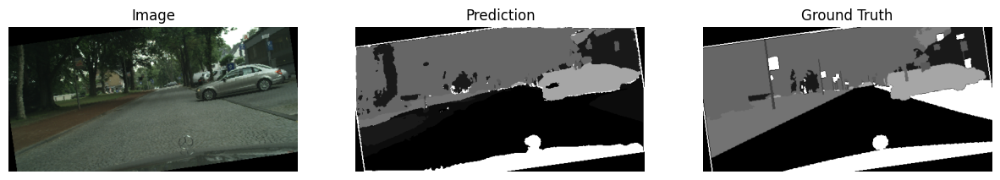

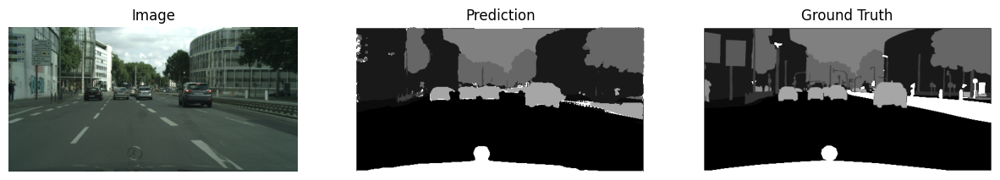

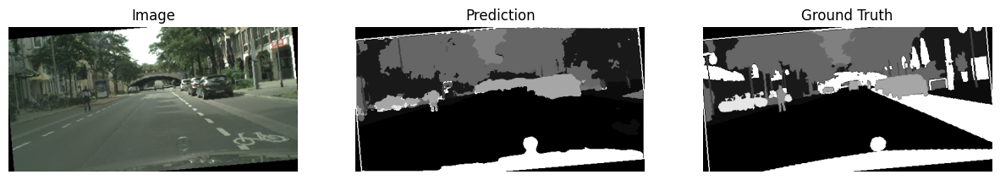

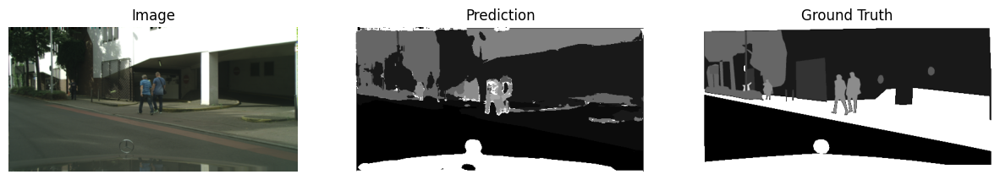

100%|██████████| 119/119 [00:33<00:00,  3.54it/s]


Validation Output


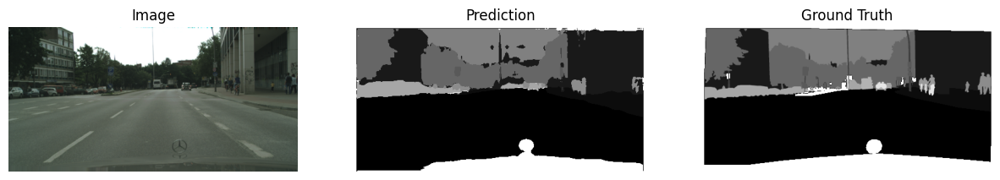

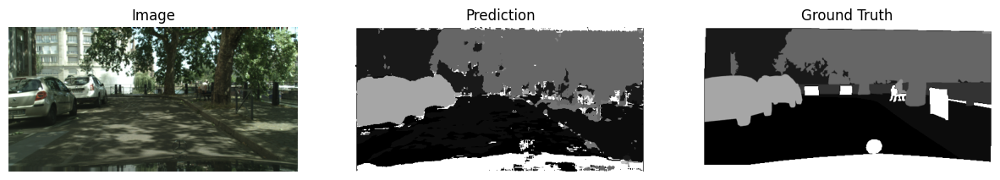

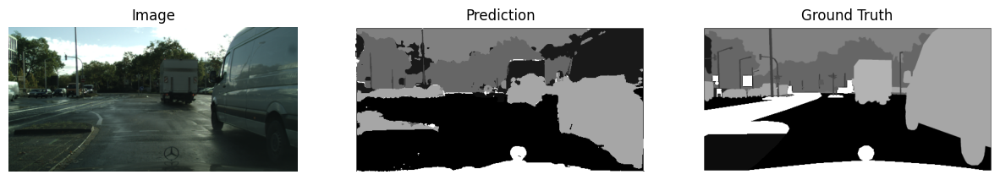

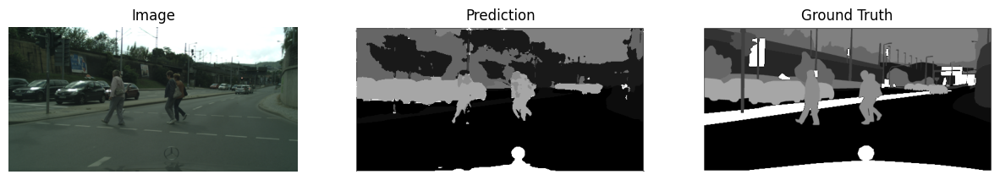

Epoch [6/100], Train Loss: 0.6832, Val Loss: 0.6892


100%|██████████| 119/119 [00:34<00:00,  3.45it/s]


Epoch [7/100], Train Loss: 0.6555, Val Loss: 0.6622


100%|██████████| 119/119 [00:34<00:00,  3.40it/s]


Epoch [8/100], Train Loss: 0.6395, Val Loss: 0.6414


100%|██████████| 119/119 [00:35<00:00,  3.40it/s]


Epoch [9/100], Train Loss: 0.6190, Val Loss: 0.6445


100%|██████████| 119/119 [00:34<00:00,  3.42it/s]


Epoch [10/100], Train Loss: 0.6025, Val Loss: 0.6316


100%|██████████| 476/476 [02:40<00:00,  2.97it/s]


Training Output


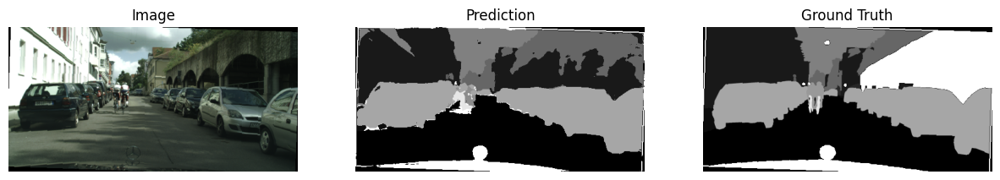

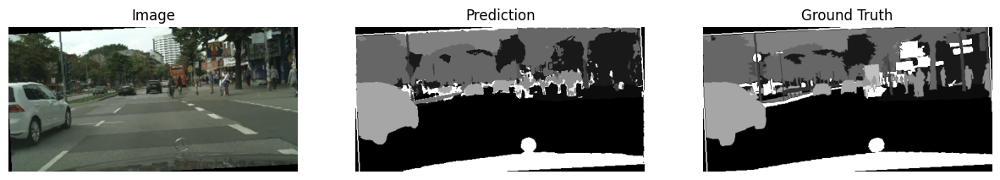

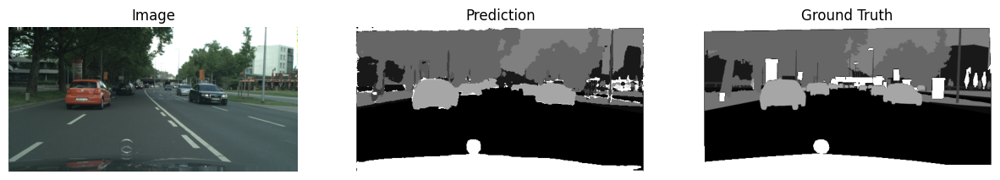

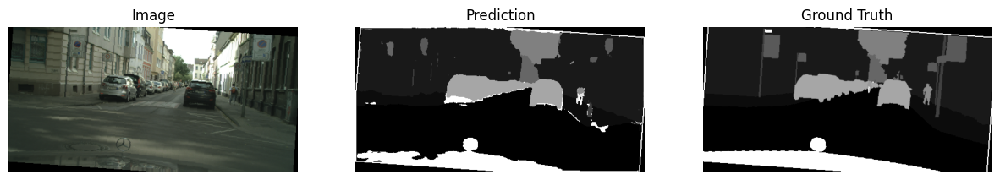

100%|██████████| 119/119 [00:33<00:00,  3.52it/s]


Validation Output


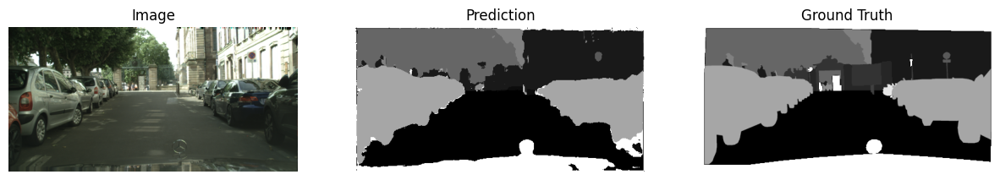

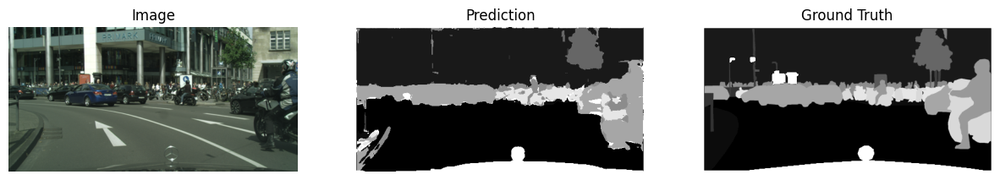

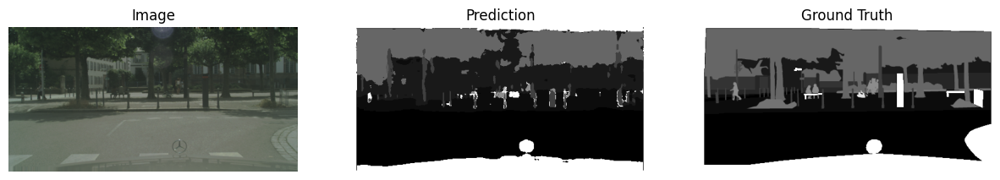

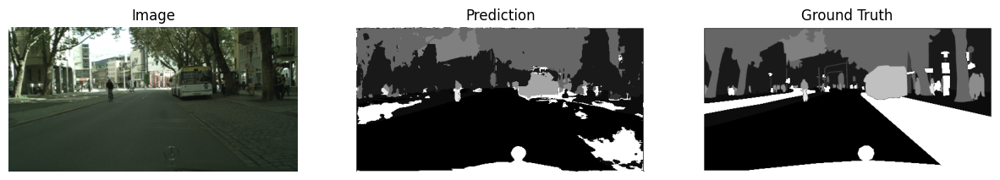

Epoch [11/100], Train Loss: 0.5852, Val Loss: 0.5817


100%|██████████| 119/119 [00:34<00:00,  3.49it/s]


Epoch [12/100], Train Loss: 0.5730, Val Loss: 0.5750


100%|██████████| 119/119 [00:33<00:00,  3.50it/s]


Epoch [13/100], Train Loss: 0.5616, Val Loss: 0.5454


100%|██████████| 119/119 [00:33<00:00,  3.55it/s]


Epoch [14/100], Train Loss: 0.5528, Val Loss: 0.5535


100%|██████████| 119/119 [00:33<00:00,  3.59it/s]


Epoch [15/100], Train Loss: 0.5407, Val Loss: 0.5384


100%|██████████| 476/476 [02:38<00:00,  3.00it/s]


Training Output


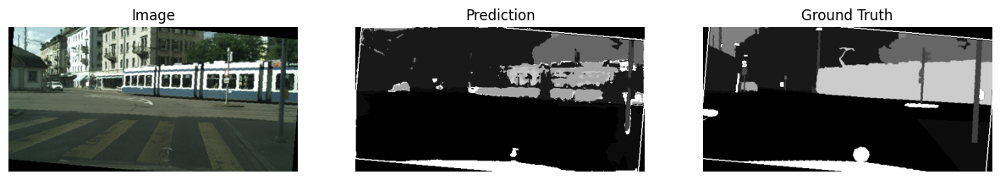

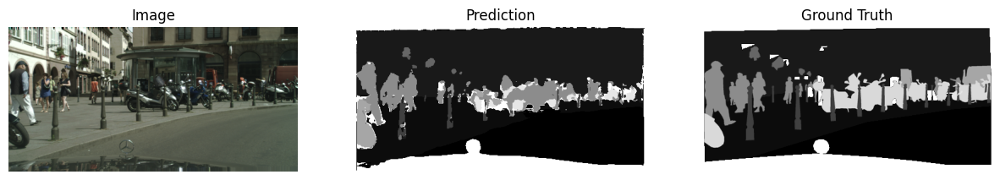

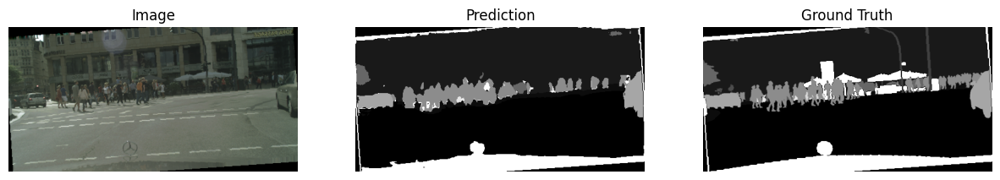

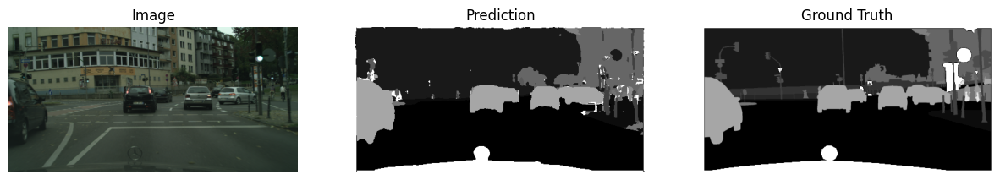

100%|██████████| 119/119 [00:34<00:00,  3.45it/s]


Validation Output


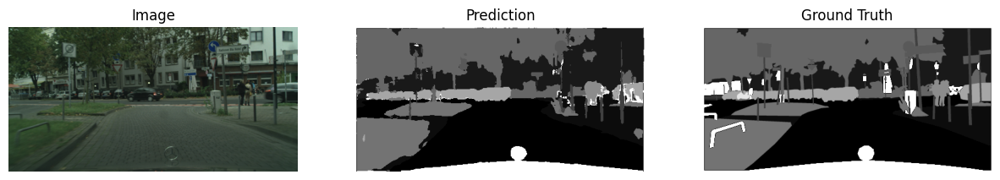

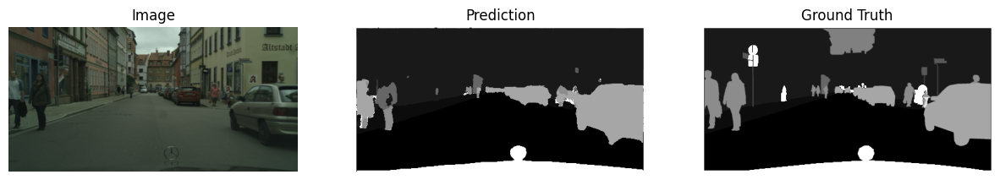

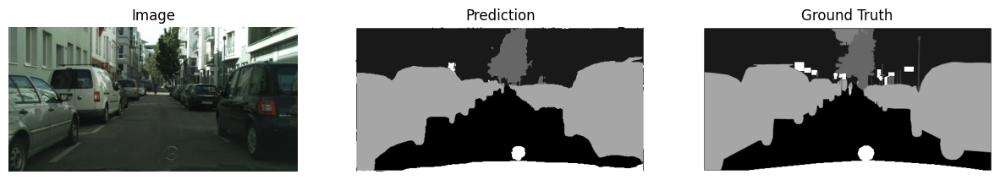

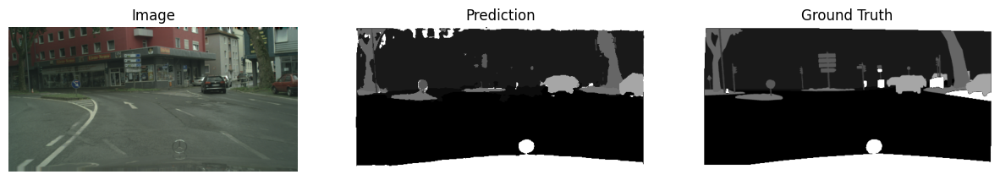

Epoch [16/100], Train Loss: 0.5295, Val Loss: 0.5863


100%|██████████| 119/119 [00:33<00:00,  3.54it/s]


Epoch [17/100], Train Loss: 0.5229, Val Loss: 0.5402


100%|██████████| 119/119 [00:33<00:00,  3.57it/s]


Epoch [18/100], Train Loss: 0.5131, Val Loss: 0.5278


100%|██████████| 119/119 [00:33<00:00,  3.57it/s]


Epoch [19/100], Train Loss: 0.5014, Val Loss: 0.5907


100%|██████████| 119/119 [00:33<00:00,  3.53it/s]


Epoch [20/100], Train Loss: 0.4993, Val Loss: 0.5119


100%|██████████| 476/476 [02:39<00:00,  2.98it/s]


Training Output


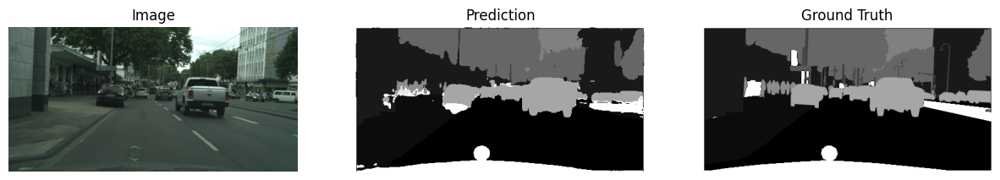

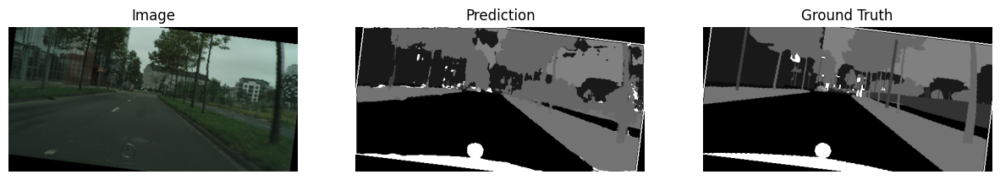

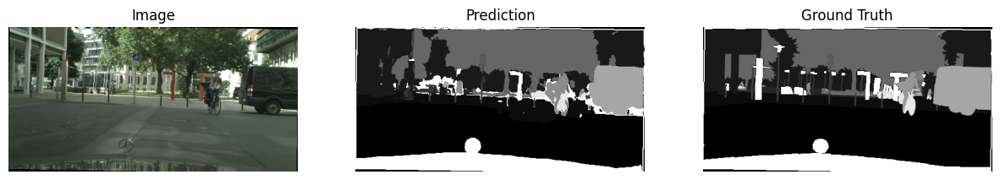

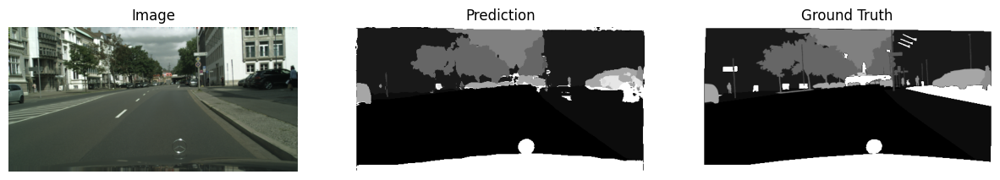

100%|██████████| 119/119 [00:33<00:00,  3.58it/s]


Validation Output


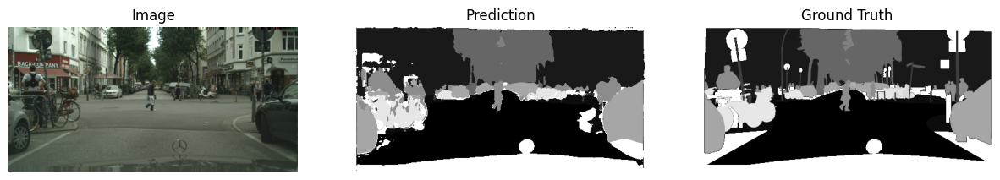

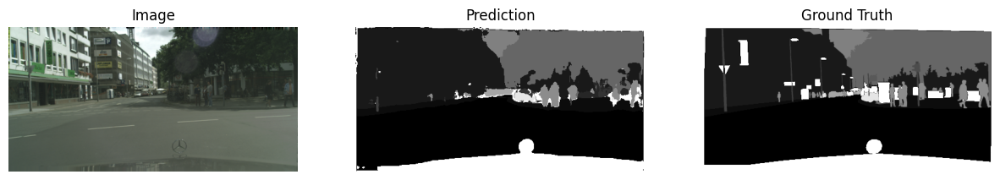

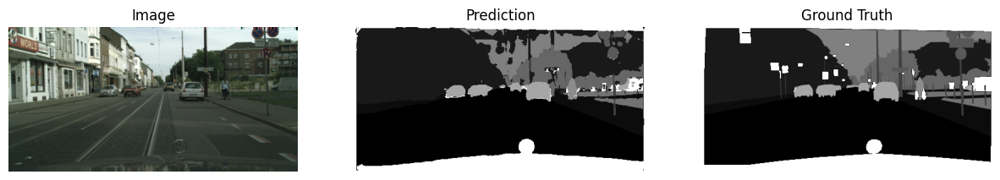

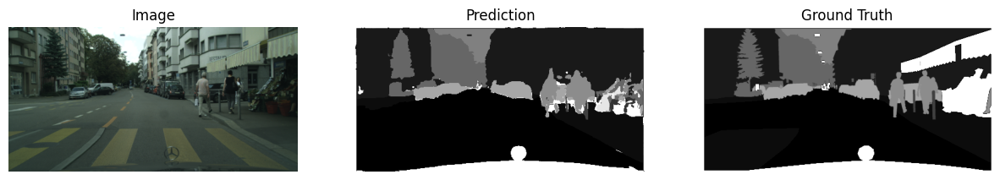

Epoch [21/100], Train Loss: 0.4936, Val Loss: 0.5319


100%|██████████| 119/119 [00:33<00:00,  3.50it/s]


Epoch [22/100], Train Loss: 0.4854, Val Loss: 0.5008


100%|██████████| 119/119 [00:34<00:00,  3.45it/s]


Epoch [23/100], Train Loss: 0.4772, Val Loss: 0.5156


100%|██████████| 119/119 [00:35<00:00,  3.40it/s]


Epoch [24/100], Train Loss: 0.4747, Val Loss: 0.5058


100%|██████████| 119/119 [00:34<00:00,  3.44it/s]


Epoch [25/100], Train Loss: 0.4655, Val Loss: 0.4756


100%|██████████| 476/476 [02:39<00:00,  2.98it/s]


Training Output


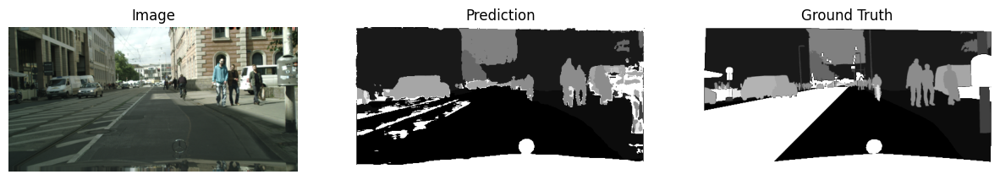

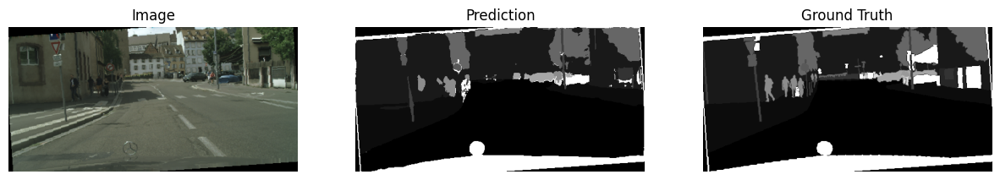

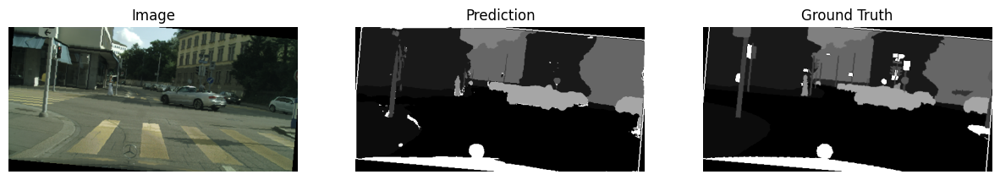

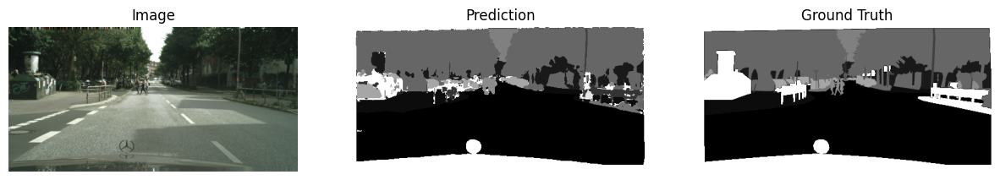

100%|██████████| 119/119 [00:33<00:00,  3.57it/s]


Validation Output


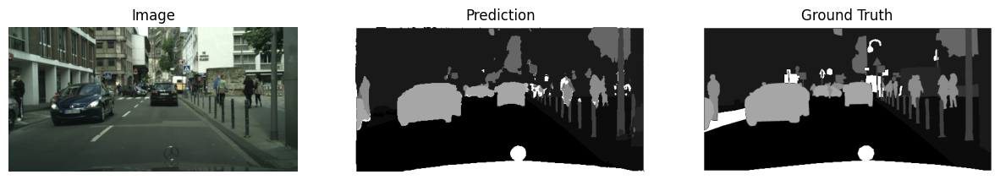

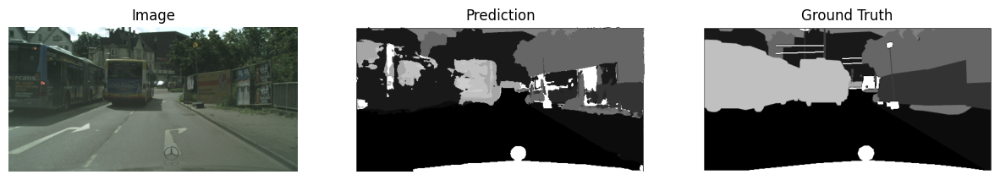

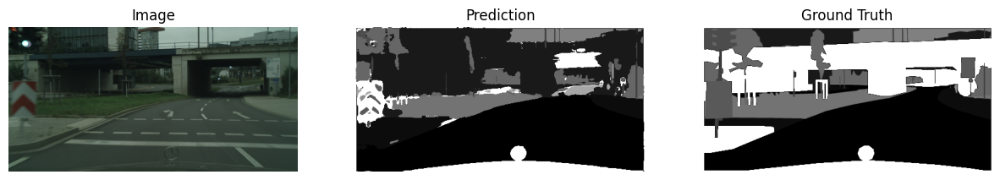

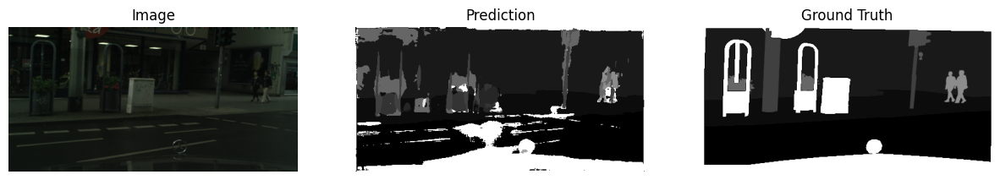

Epoch [26/100], Train Loss: 0.4637, Val Loss: 0.4765


100%|██████████| 119/119 [00:34<00:00,  3.49it/s]


Epoch [27/100], Train Loss: 0.4589, Val Loss: 0.4671


100%|██████████| 119/119 [00:33<00:00,  3.58it/s]


Epoch [28/100], Train Loss: 0.4523, Val Loss: 0.4631


100%|██████████| 119/119 [00:33<00:00,  3.52it/s]


Epoch [29/100], Train Loss: 0.4475, Val Loss: 0.4611


100%|██████████| 119/119 [00:34<00:00,  3.46it/s]


Epoch [30/100], Train Loss: 0.4383, Val Loss: 0.4677


100%|██████████| 476/476 [02:40<00:00,  2.97it/s]


Training Output


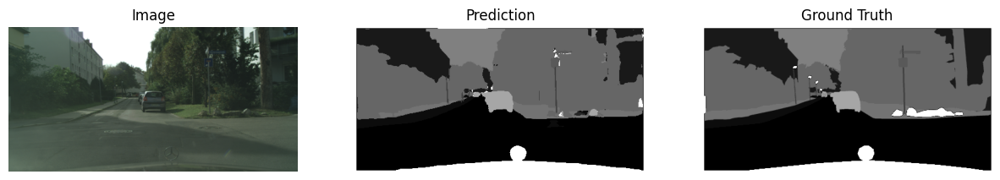

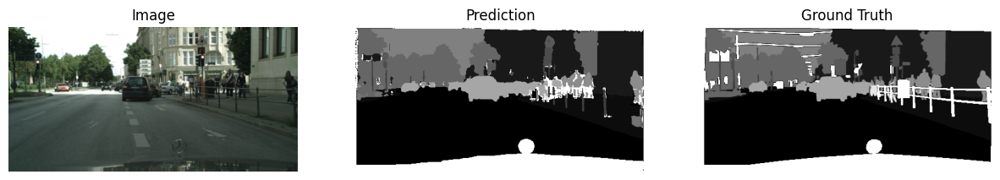

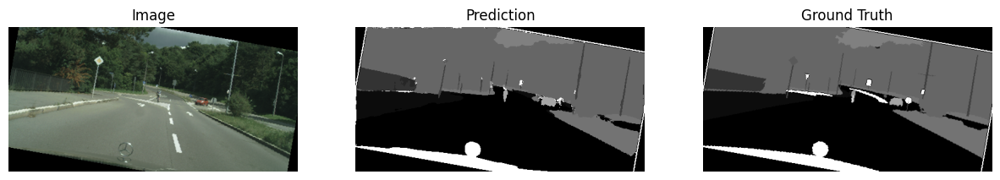

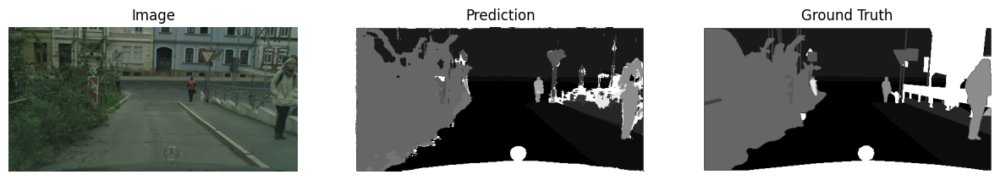

100%|██████████| 119/119 [00:33<00:00,  3.55it/s]


Validation Output


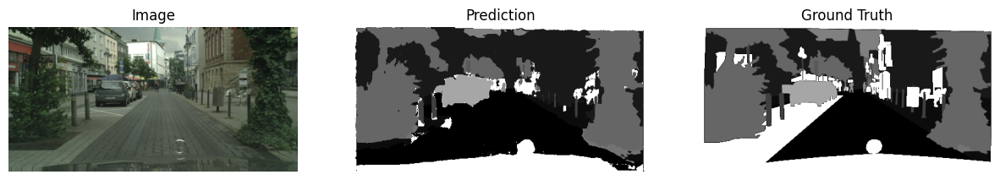

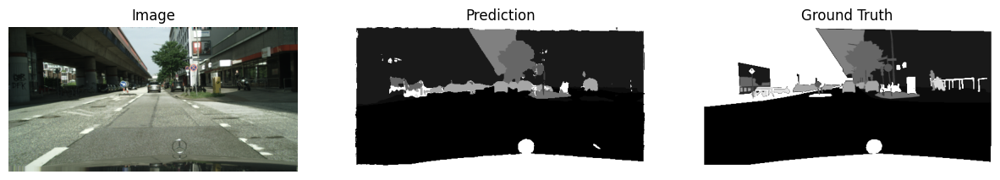

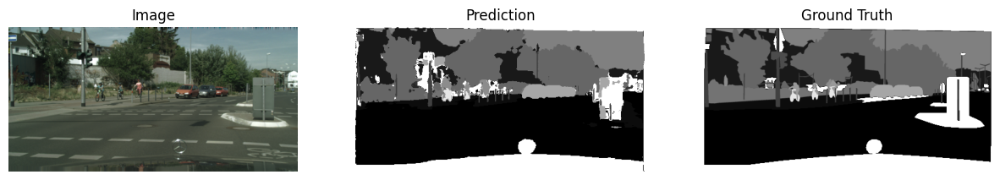

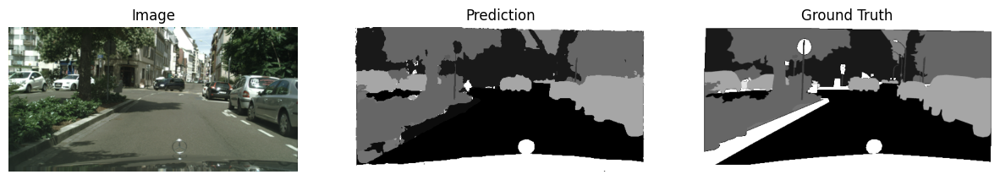

Epoch [31/100], Train Loss: 0.4376, Val Loss: 0.5038


100%|██████████| 119/119 [00:33<00:00,  3.60it/s]


Epoch [32/100], Train Loss: 0.4346, Val Loss: 0.4837


100%|██████████| 119/119 [00:33<00:00,  3.55it/s]


Epoch [33/100], Train Loss: 0.4292, Val Loss: 0.4446


100%|██████████| 119/119 [00:33<00:00,  3.57it/s]


Epoch [34/100], Train Loss: 0.4228, Val Loss: 0.4501


100%|██████████| 119/119 [00:33<00:00,  3.54it/s]


Epoch [35/100], Train Loss: 0.4206, Val Loss: 0.4500


100%|██████████| 476/476 [02:39<00:00,  2.99it/s]


Training Output


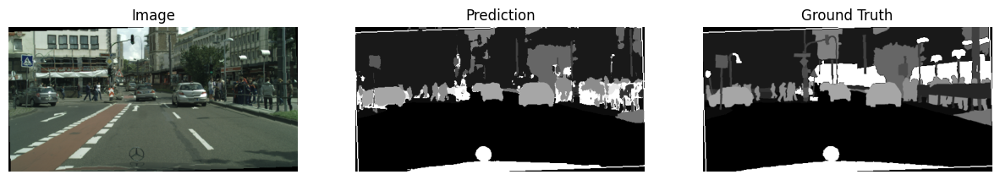

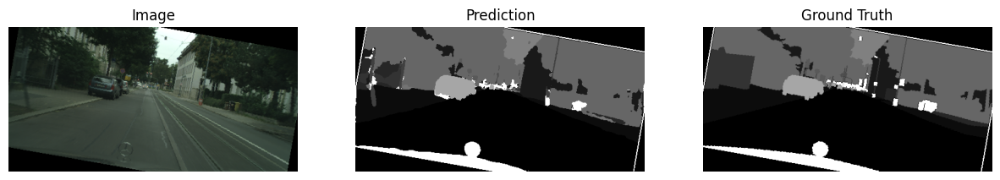

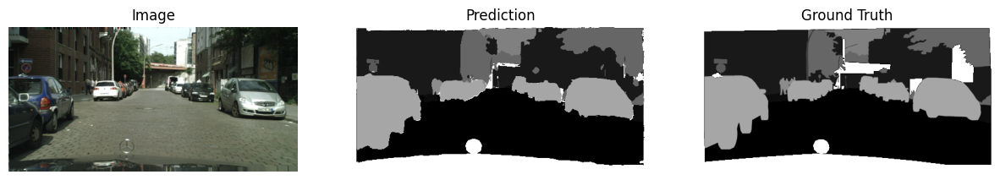

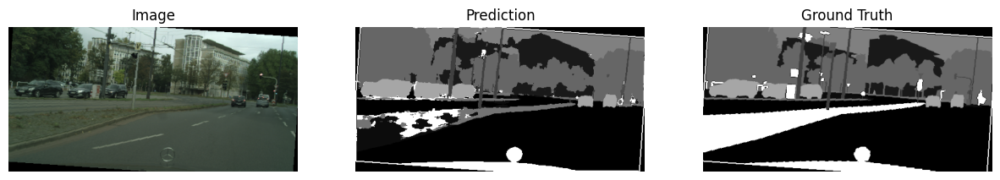

100%|██████████| 119/119 [00:32<00:00,  3.62it/s]


Validation Output


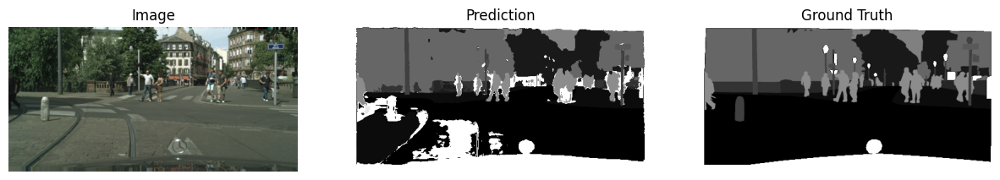

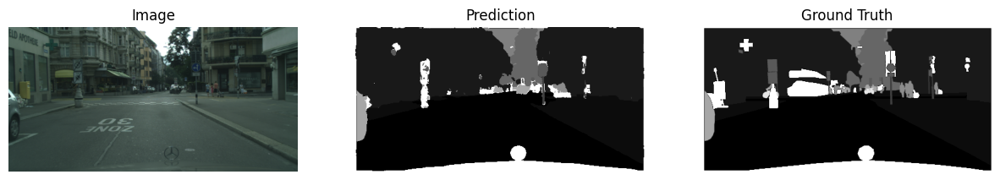

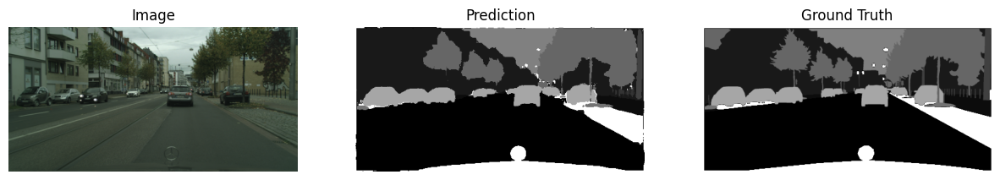

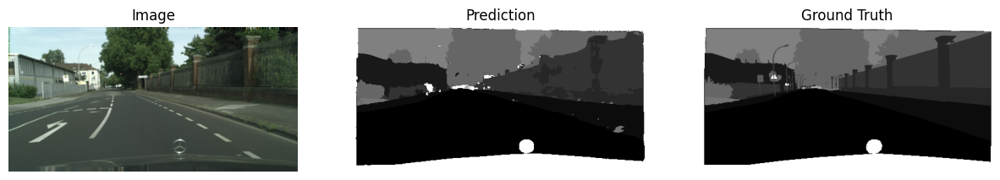

Epoch [36/100], Train Loss: 0.4134, Val Loss: 0.4520


100%|██████████| 119/119 [00:33<00:00,  3.56it/s]


Epoch [37/100], Train Loss: 0.4148, Val Loss: 0.4516


100%|██████████| 119/119 [00:34<00:00,  3.43it/s]


Epoch [38/100], Train Loss: 0.4044, Val Loss: 0.4443


100%|██████████| 119/119 [00:34<00:00,  3.50it/s]


Epoch [39/100], Train Loss: 0.3999, Val Loss: 0.4457


100%|██████████| 119/119 [00:34<00:00,  3.47it/s]


Epoch [40/100], Train Loss: 0.4008, Val Loss: 0.4462


100%|██████████| 476/476 [02:37<00:00,  3.01it/s]


Training Output


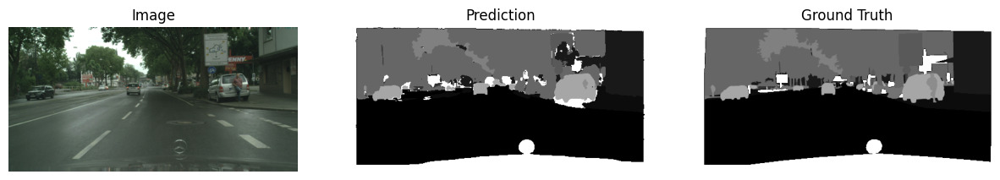

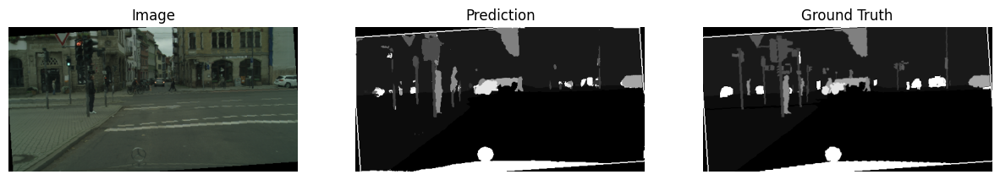

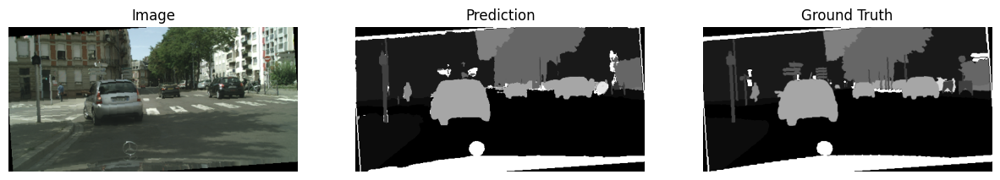

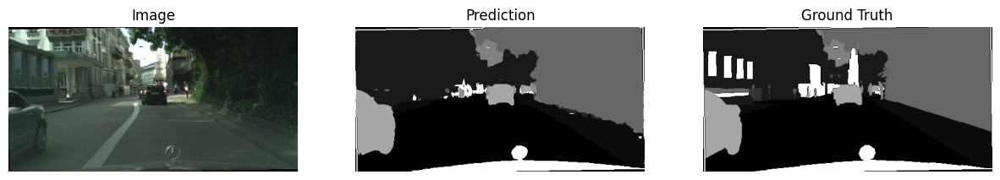

100%|██████████| 119/119 [00:32<00:00,  3.63it/s]


Validation Output


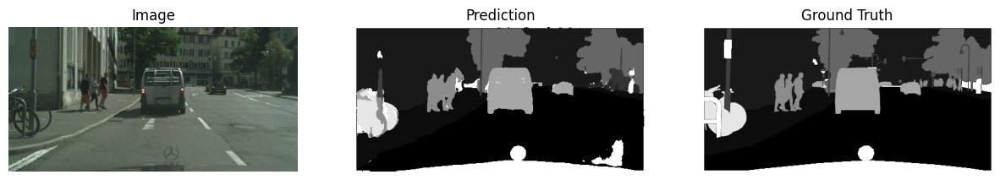

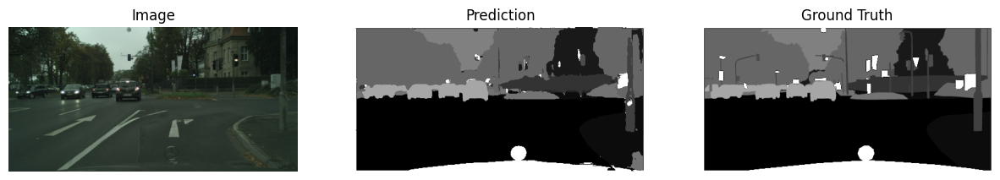

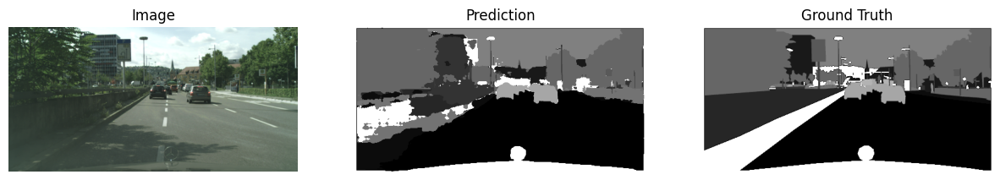

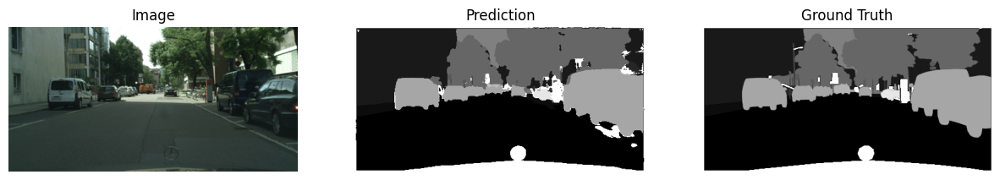

Epoch [41/100], Train Loss: 0.3931, Val Loss: 0.4568


100%|██████████| 119/119 [00:33<00:00,  3.51it/s]


Epoch [42/100], Train Loss: 0.3869, Val Loss: 0.5343


100%|██████████| 119/119 [00:34<00:00,  3.49it/s]


Epoch [43/100], Train Loss: 0.3944, Val Loss: 0.4422


100%|██████████| 119/119 [00:35<00:00,  3.39it/s]


Epoch [44/100], Train Loss: 0.3831, Val Loss: 0.4697


100%|██████████| 119/119 [00:33<00:00,  3.57it/s]


Epoch [45/100], Train Loss: 0.3729, Val Loss: 0.4678


100%|██████████| 476/476 [02:39<00:00,  2.99it/s]


Training Output


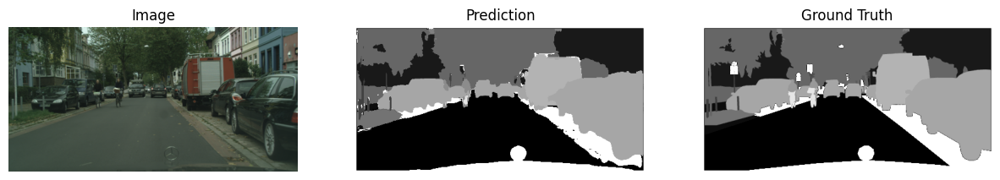

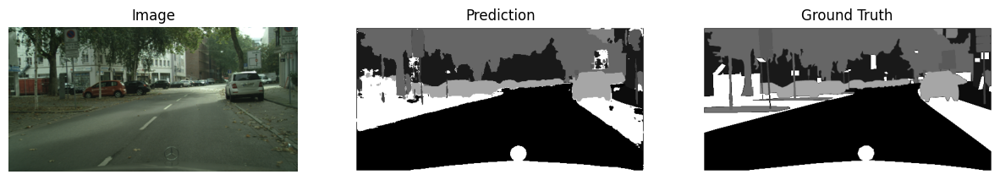

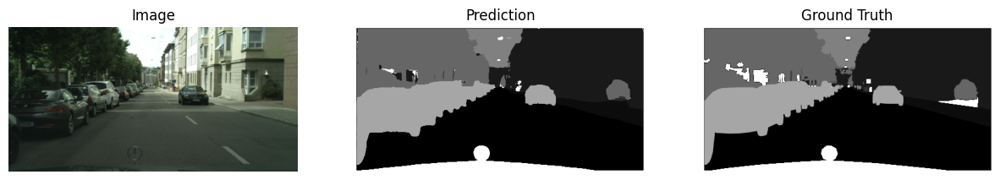

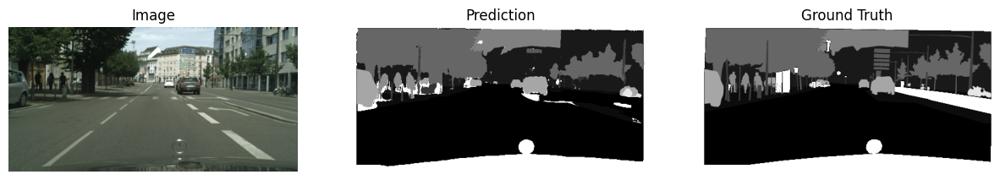

100%|██████████| 119/119 [00:34<00:00,  3.49it/s]


Validation Output


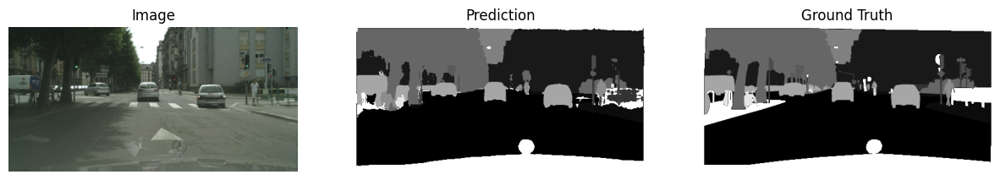

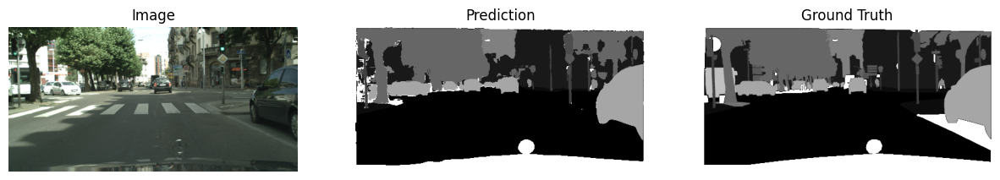

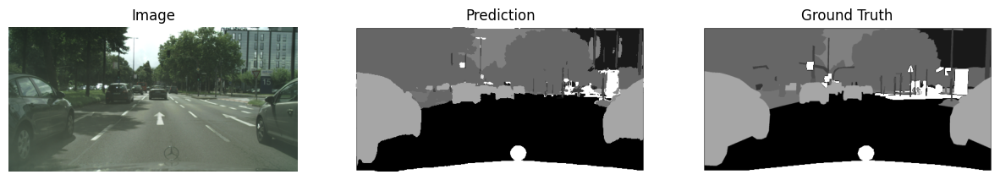

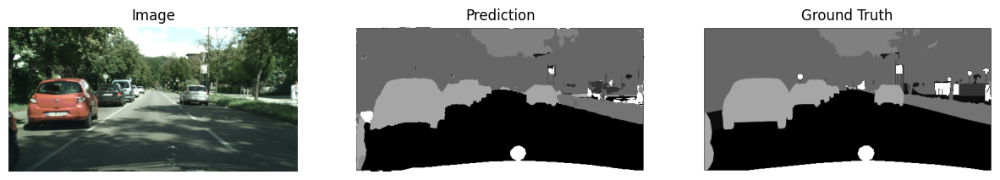

Epoch [46/100], Train Loss: 0.3793, Val Loss: 0.4612


100%|██████████| 119/119 [00:32<00:00,  3.62it/s]


Epoch [47/100], Train Loss: 0.3689, Val Loss: 0.4270


100%|██████████| 119/119 [00:34<00:00,  3.50it/s]


Epoch [48/100], Train Loss: 0.3710, Val Loss: 0.4456


100%|██████████| 119/119 [00:33<00:00,  3.56it/s]


Epoch [49/100], Train Loss: 0.3672, Val Loss: 0.4760


100%|██████████| 119/119 [00:33<00:00,  3.61it/s]


Epoch [50/100], Train Loss: 0.3636, Val Loss: 0.4210


100%|██████████| 476/476 [02:38<00:00,  3.00it/s]


Training Output


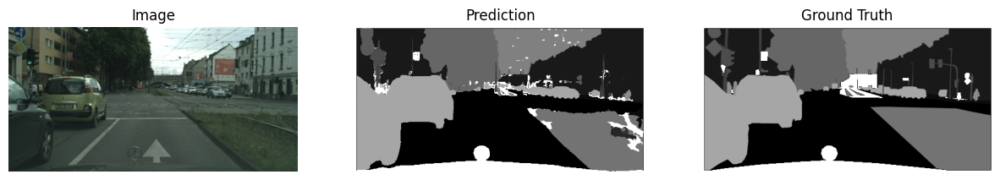

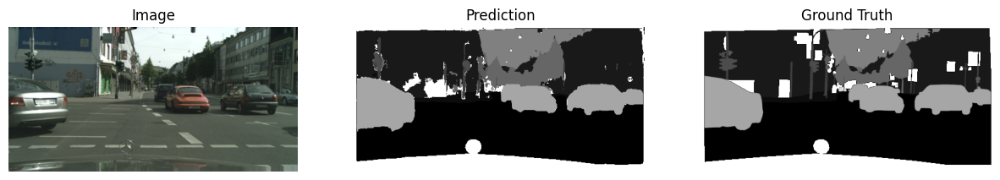

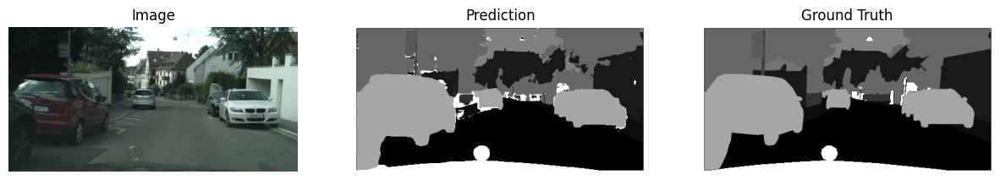

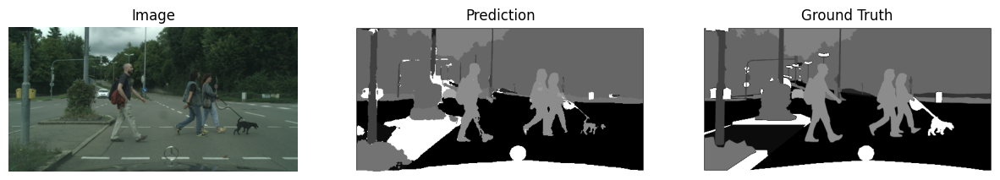

100%|██████████| 119/119 [00:33<00:00,  3.57it/s]


Validation Output


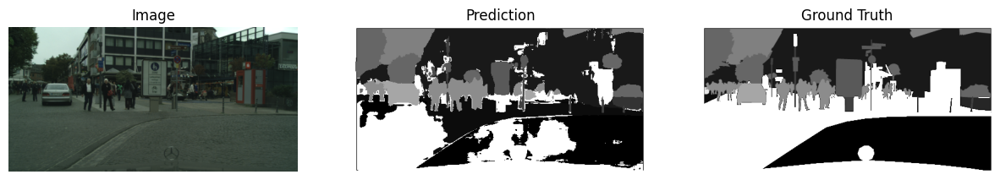

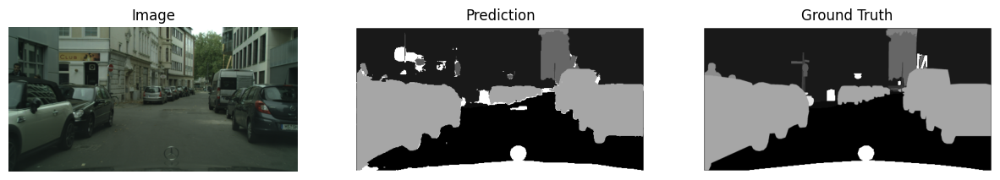

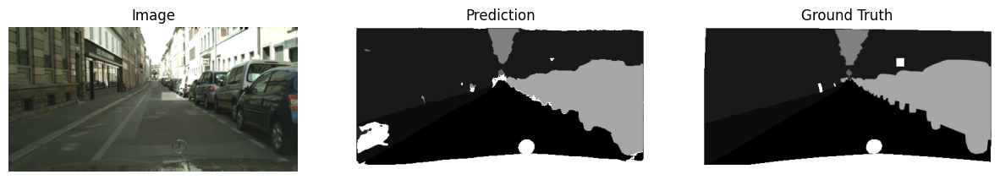

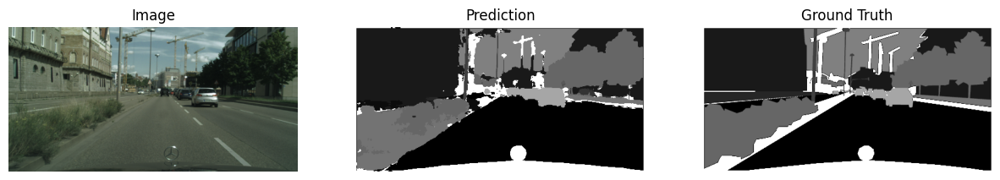

Epoch [51/100], Train Loss: 0.3610, Val Loss: 0.4619


100%|██████████| 119/119 [00:34<00:00,  3.47it/s]


Epoch [52/100], Train Loss: 0.3516, Val Loss: 0.4455


100%|██████████| 119/119 [00:34<00:00,  3.49it/s]


Epoch [53/100], Train Loss: 0.3531, Val Loss: 0.4249


100%|██████████| 119/119 [00:32<00:00,  3.64it/s]


Epoch [54/100], Train Loss: 0.3506, Val Loss: 0.4645


100%|██████████| 119/119 [00:32<00:00,  3.63it/s]

Epoch [55/100], Train Loss: 0.3450, Val Loss: 0.4832
Early stopping triggered.
Finished Training


In [24]:
train_losses, val_losses = train_model(model, dl_train, dl_val, num_epochs=100,device=device, criterion=criterion, optimizer=optimizer, patience=5)

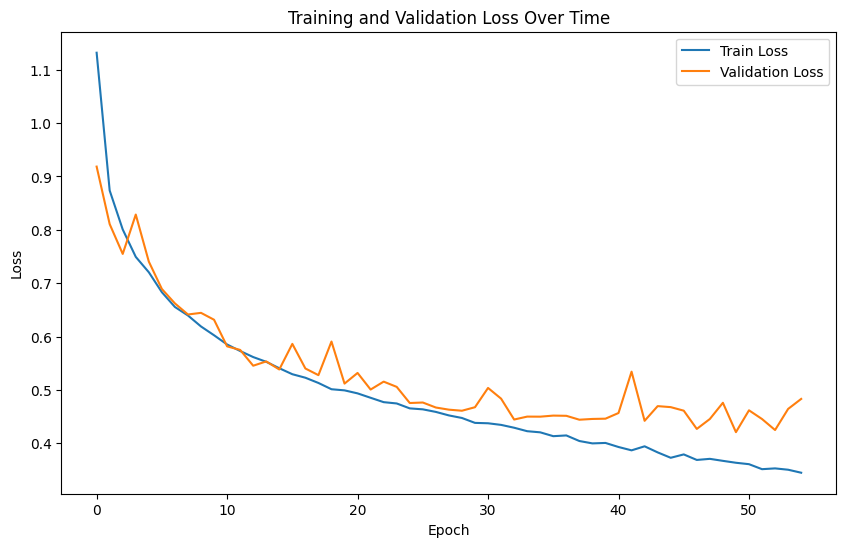

In [25]:
#TODO : Plot losses and metrics graphs
plt.figure(figsize=(10, 6))
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Time')
plt.legend()
plt.show()

## Loading the best model for testing

In [14]:
model.load_state_dict(torch.load(r'/kaggle/input/unet/pytorch/default/1/UNET.pth'))

<All keys matched successfully>

In [27]:
def dice_score(preds, labels, num_classes=21, epsilon=1e-6):

    # Convert labels to one-hot encoding
    preds_one_hot = torch.nn.functional.one_hot(preds, num_classes=num_classes)
    labels_one_hot = torch.nn.functional.one_hot(labels, num_classes=num_classes)

    # Flatten the tensors
    preds_one_hot = preds_one_hot.view(-1, num_classes).float()
    labels_one_hot = labels_one_hot.view(-1, num_classes).float()

    # Compute intersection and union
    intersection = torch.sum(preds_one_hot * labels_one_hot, dim=0)
    union = torch.sum(preds_one_hot, dim=0) + torch.sum(labels_one_hot, dim=0)

    # Compute Dice scores for each class
    dice_scores = (2 * intersection + epsilon) / (union + epsilon)

    # Compute mean Dice score
    mean_dice = dice_scores.mean().item()
    return mean_dice

def iou_score(preds, labels, num_classes=21, epsilon=1e-6):

    iou_scores = []
    for cls in range(num_classes):
        # Create binary masks for the current class
        pred_mask = (preds == cls).float()
        label_mask = (labels == cls).float()

        # Calculate intersection and union
        intersection = torch.sum(pred_mask * label_mask)
        union = torch.sum(pred_mask) + torch.sum(label_mask) - intersection

        # Compute IoU score for the current class
        iou = (intersection + epsilon) / (union + epsilon)
        iou_scores.append(iou.item())

    # Calculate mean IoU score across all classes
    mean_iou = sum(iou_scores) / num_classes
    return mean_iou

In [28]:
model.eval()  
model = model.to(device)  
total_dice = 0.0
total_iou = 0.0
num_batches = 0

with torch.no_grad():  
    for inputs, labels in tqdm(dl_val):
        inputs = inputs.to(device)
        labels = labels.to(device)
        
        if labels.ndim == 4:  # Shape: [batch_size, num_classes, height, width]
            labels = torch.argmax(labels, dim=1)  # Shape: [batch_size, height, width]

        # Forward pass
        output = model(inputs)

        preds = torch.argmax(output, dim=1)  # Shape: [batch_size, height, width]

        dice = dice_score(preds, labels, num_classes=21)
        iou = iou_score(preds, labels, num_classes=21)
        total_dice += dice
        total_iou += iou
        num_batches += 1

average_dice = total_dice / num_batches
average_iou = total_iou / num_batches

print(f"Average Dice Score: {average_dice}")
print(f"Average IoU Score: {average_iou}")

100%|██████████| 119/119 [00:35<00:00,  3.36it/s]

Average Dice Score: 0.44056806043416513
Average IoU Score: 0.3653552937359002


  1%|          | 4/595 [00:00<02:16,  4.32it/s]


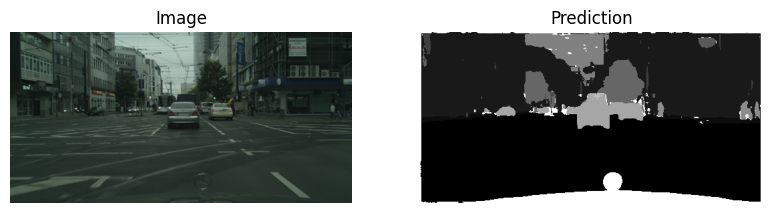

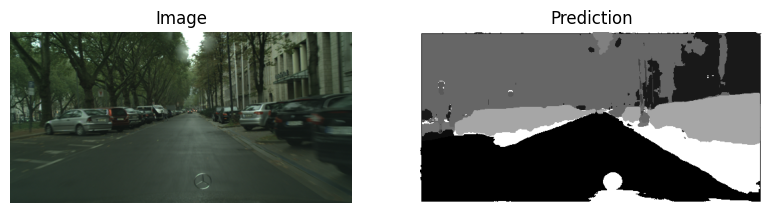

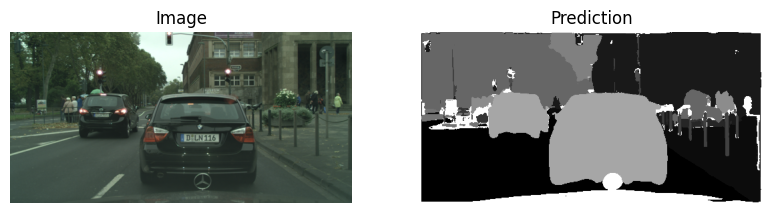

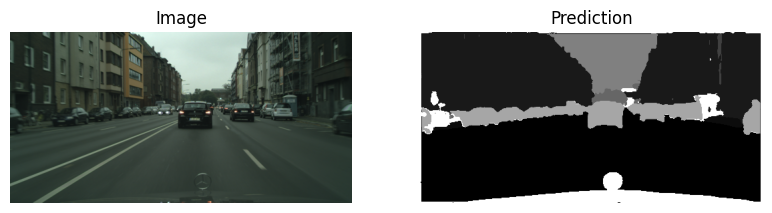

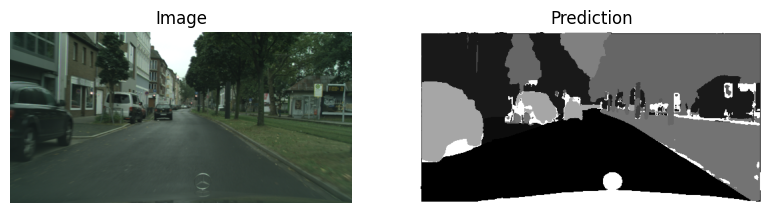

In [44]:
#TODO : Test your model and show some samples
model.eval()

# Store some samples for visualization
sample_images = []
sample_predictions = []

with torch.no_grad():
    for image, _ in tqdm(dl_test):  
        image = image.to(device)
        
        predictions = model(image)
        
        predictions_numpy = predictions.cpu().numpy()
        
        sample_images.append(image.cpu().numpy())
        sample_predictions.append(predictions_numpy)
        
        # Limit to first 5 samples for display purposes
        if len(sample_images) >= 5:
            break

def show_samples(imgs, outputs):
    for img, output in zip(imgs, outputs):
        
        # Remove the batch dimension and transpose to (H, W, 3) for RGB image
        img = np.transpose(img.squeeze(0), (1, 2, 0))  # from (1, 3, 256, 512) to (256, 512, 3)

        # Ensure that output is transposed and has class labels for display
        output = torch.argmax(torch.tensor(output), dim=1).squeeze(0).numpy()  # from (1, 21, 256, 512) to (256, 512)

        plt.figure(figsize=(15, 5))

        # Display the image
        plt.subplot(1, 3, 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title('Image')

        # Display the predicted mask
        plt.subplot(1, 3, 2)
        plt.imshow(output, cmap='gray')
        plt.axis('off')
        plt.title('Prediction')

    plt.show()

show_samples(sample_images, sample_predictions)

{0: (128, 64, 128), 1: (244, 35, 232), 2: (70, 70, 70), 3: (102, 102, 156), 4: (190, 153, 153), 5: (153, 153, 153), 6: (250, 170, 30), 7: (220, 220, 0), 8: (107, 142, 35), 9: (152, 251, 152), 10: (70, 130, 180), 11: (220, 20, 60), 12: (255, 0, 0), 13: (0, 0, 142), 14: (0, 0, 70), 15: (0, 60, 100), 16: (0, 80, 100), 17: (0, 0, 230), 18: (119, 11, 32), 19: (0, 0, 142), 20: (0, 0, 0)}


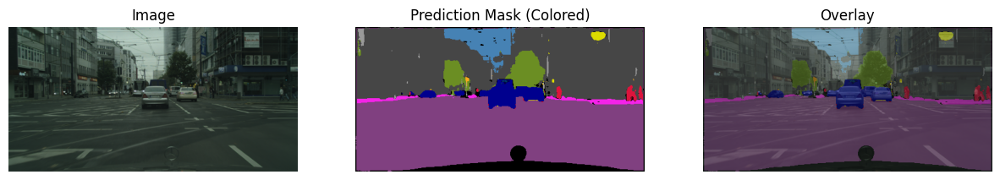

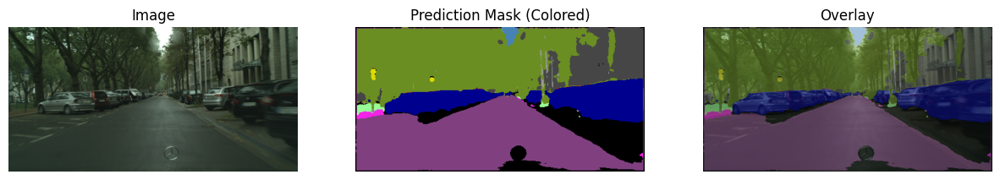

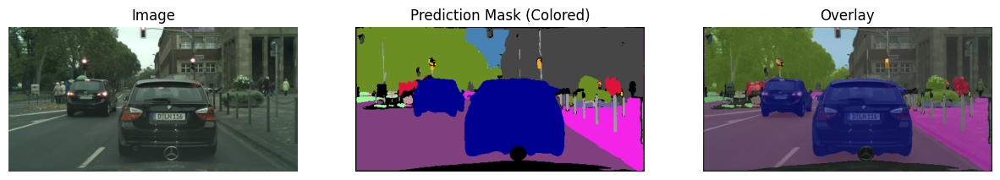

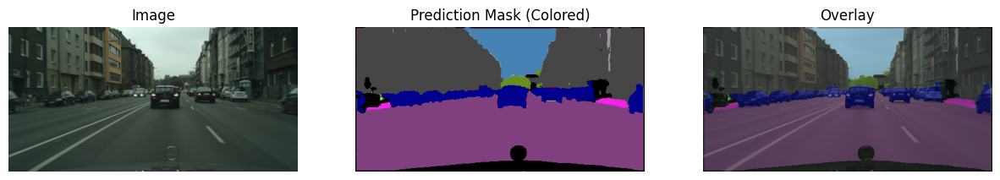

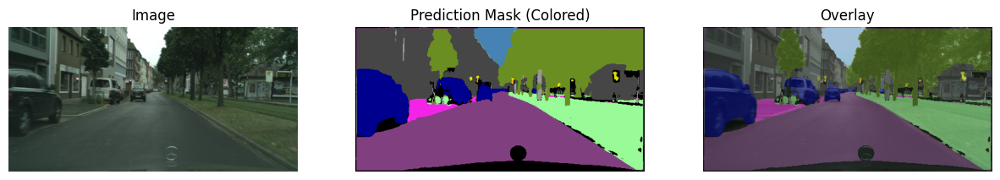

In [52]:
def mask_to_color(mask, trainId_to_color):
    """Convert mask with trainId values to RGB using the color mapping."""
    colored_mask = np.zeros((mask.shape[0], mask.shape[1], 3), dtype=np.uint8)  # H x W x 3 (RGB)

    for trainId, color in trainId_to_color.items():
        colored_mask[mask == trainId] = color
    
    return colored_mask

def overlay_mask_on_image(image, colored_mask, alpha=0.5):
    """Overlay the colored mask on top of the original image."""
    image = (image * 255).astype(np.uint8)  # Ensure image is in uint8
    colored_mask = colored_mask.astype(np.uint8)  # Ensure mask is in uint8
    
    # Convert to PIL images
    image_pil = Image.fromarray(image)
    colored_mask_pil = Image.fromarray(colored_mask)
    
    # Overlay the mask on the image using blending
    overlay = Image.blend(image_pil, colored_mask_pil, alpha=alpha)
    return overlay

def show_samples_with_overlay(imgs, outputs, trainId_to_color):
    for img, output in zip(imgs, outputs):
        
        # Convert the prediction to the trainId map (argmax across classes)
        mask = torch.argmax(torch.tensor(output), dim=1).squeeze(0).numpy()  # (256, 512)
        
        # Convert mask to RGB using the color mapping
        colored_mask = mask_to_color(mask, trainId_to_color)

        # Overlay the mask on the image
        img = np.transpose(img.squeeze(0), (1, 2, 0))  # Convert image from (1, 3, 256, 512) to (256, 512, 3)
        overlay = overlay_mask_on_image(img, colored_mask)

        # Plot original image, colored mask, and overlay
        plt.figure(figsize=(15, 5))

        # Display the image
        plt.subplot(1, 3, 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title('Image')

        # Display the colored mask
        plt.subplot(1, 3, 2)
        plt.imshow(colored_mask)
        plt.axis('off')
        plt.title('Prediction Mask (Colored)')

        # Display the overlay
        plt.subplot(1, 3, 3)
        plt.imshow(overlay)
        plt.axis('off')
        plt.title('Overlay')

    plt.show()

trainId_to_color = {x:find_color(x) for x in range(21)}
print(trainId_to_color)
    
# Call the function to display the result
show_samples_with_overlay(sample_images, sample_predictions, trainId_to_color)